In [1]:
import numpy as np 
import pickle
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd

In [2]:
file_name = r'../data/centroids_all_NOR_1x1.pkl'
with open(r"../data/centroids_all_NOR_1x1.pkl", "rb") as file:
    df_2020 = pickle.load(file)

df_2020

,geometry,latitude,longitude
0,"POLYGON ((-113396.708 6723593.459, -113453.164...",60.184377,3.906250
1,"POLYGON ((-77147.252 6615574.499, -77162.706 6...",59.283751,4.848241
2,"POLYGON ((-75472.701 6617359.522, -75472.701 6...",59.297719,4.867749
3,"POLYGON ((-75472.701 6618359.522, -75472.701 6...",59.304152,4.862960
4,"POLYGON ((-75472.701 6618359.522, -76100.492 6...",59.310679,4.862359
...,...,...,...
346441,"POLYGON ((1113527.299 7802359.522, 1113527.299...",69.607836,30.939583
346442,"POLYGON ((1113527.299 7803359.522, 1113527.299...",69.616178,30.942661
346443,"POLYGON ((1113527.299 7804359.522, 1113527.299...",69.622347,30.944938
346444,"POLYGON ((1114527.299 7800359.522, 1114562.802...",69.584592,30.942218


In [3]:
# Ensure geometries are in lat/lon (WGS84)
df_2020 = df_2020.to_crs(epsg=4326)

# Get centroids of polygons
df_2020['centroid'] = df_2020.geometry.centroid

# Extract lat/lon from centroids
df_2020['lat'] = df_2020.centroid.y
df_2020['lon'] = df_2020.centroid.x

# Define bin size
bin_size = 0.08

# Create lat/lon bins
df_2020['lat_bin'] = (df_2020['lat'] / bin_size).round(0) * bin_size
df_2020['lon_bin'] = (df_2020['lon'] / bin_size).round(0) * bin_size

# Sample one centroid per bin
sampled = df_2020.groupby(['lat_bin', 'lon_bin']).sample(n=1, random_state=42).reset_index(drop=True)

print(f"Sampled: {len(sampled)} polygons")


C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3750591863.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  df_2020['centroid'] = df_2020.geometry.centroid
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3750591863.py:8: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  df_2020['lat'] = df_2020.centroid.y
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3750591863.py:9: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  df_2020['lon'] = df_2020.centroid.x


Sampled: 11470 polygons


In [4]:
sampled

,geometry,latitude,longitude,centroid,lat,lon,lat_bin,lon_bin
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,POINT (6.99775 58.02829),58.028286,6.997755,58.0,6.96
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,POINT (7.05014 58.02217),58.022171,7.050138,58.0,7.04
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,POINT (7.08638 57.99091),57.990907,7.086381,58.0,7.12
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,POINT (7.21969 58.02657),58.026571,7.219693,58.0,7.20
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,POINT (7.28573 58.02973),58.029728,7.285729,58.0,7.28
...,...,...,...,...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,POINT (25.5495 71.16069),71.160690,25.549503,71.2,25.52
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,POINT (25.62173 71.1602),71.160205,25.621730,71.2,25.60
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,POINT (25.66277 71.17527),71.175275,25.662774,71.2,25.68
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,POINT (25.79059 71.16668),71.166685,25.790593,71.2,25.76


### Plotting Samples Distribution

In [5]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

def plotting_samples_norway(df):    
    # Load the shapefile of Norway's boundaries (assuming you have this shapefile)
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)  # Make sure it's in EPSG:4326 for plotting
    
    # Step 2: Plot the map
    fig, ax = plt.subplots(figsize=(10, 10))
    
    # Plot the Norway boundary
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    
    # Assuming 'result' DataFrame has columns 'longitude' and 'latitude' (from the grid centroids)
    result_geo_df = gpd.GeoDataFrame(
        df, 
        geometry=gpd.points_from_xy(df.longitude, df.latitude),
        crs="EPSG:4326"  # Ensure the correct CRS
    )
    
    # Plot the filtered points inside Norway
    result_geo_df.plot(ax=ax, markersize=3, color='red', alpha=0.5, label="Assemblages")
    
    # Customize plot
    ax.set_title("Randomly Sampled Grids 2060-2080", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.legend()
    
    # Show the plot
    plt.show()

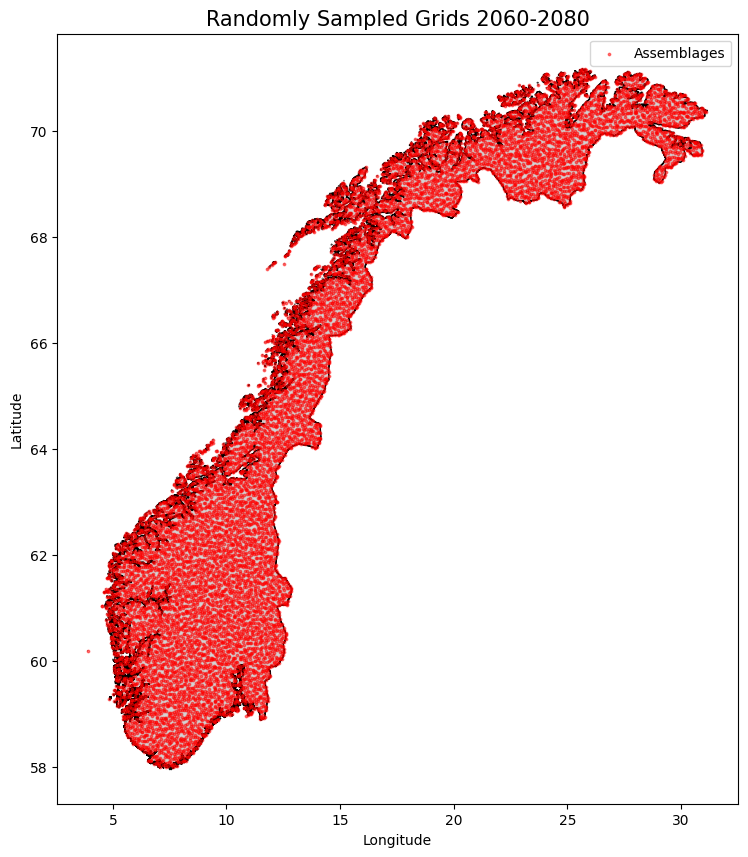

In [6]:
plotting_samples_norway(sampled)

### Generating Climatic Maps

In [7]:
import netCDF4  # or import h5netcdf
import xarray as xr
import cartopy.crs as ccrs
import cartopy.feature as cfeature

In [8]:
def read_netcdf_stack(file_paths, latitude, longitude, grid):
    patches = []
    # scaler = MinMaxScaler(feature_range=(0, 1))  # Define the scaler

    for file_path in file_paths:
        data = xr.open_dataset(file_path)
        variable = list(data.data_vars.keys())[-1]

        lat_idx = np.argmin(np.abs(data['lat'].values - latitude))
        lon_idx = np.argmin(np.abs(data['lon'].values - longitude))

        patch = data[variable].isel(
            lat=slice(lat_idx - grid, lat_idx + grid),
            lon=slice(lon_idx - grid, lon_idx + grid)
        ).fillna(0).values  # Convert to NumPy

        print(f"Shape of patch for {file_path} {variable}: {patch.shape}")

        # Remove extra dimension if necessary
        if patch.shape[0] == 1:
            patch = patch[0]

        # # Reshape for MinMax scaling (flatten to 2D)
        # patch_reshaped = patch.reshape(-1, 1)  # Flatten but keep 1 feature

        # # Apply MinMax Scaling
        # patch_scaled = scaler.fit_transform(patch_reshaped)

        # # Reshape back to original (grid*2, grid*2)
        # patch_scaled = patch_scaled.reshape(patch.shape)

        # patches.append(patch_scaled)  # Add scaled patch
        
        patches.append(patch)  # Add NOT scaled patch


    # Stack along last axis (channels dimension)
    stacked_patches = np.stack(patches, axis=-1)

    return stacked_patches

In [9]:
# Define the file paths for each variable (you need to have the full paths for each variable)
path_altitude = r"C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc"

variables =['gdd5','bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd']
scenario = 'rcp85'
year = '2021-2040'
# year = '2061-2080'
stacked_patches_list = []
# x = 100
for i in range(sampled.shape[0]): # gbif_assemblages.shape[0]
    sample =  sampled.iloc[i]
    file_paths = [f"../data/Future/HIRHAM5/{scenario}/{year}/CHELSA_HIRHAM5_{scenario}_{var}_{year}_V.1.0.nc" for var in variables]
    file_paths.append(path_altitude)
    
    # Call the function to get the stacked patches
    stacked_patches = read_netcdf_stack(file_paths = file_paths, 
                                        latitude = sample.latitude, 
                                        longitude = sample.longitude, 
                                        grid = 16) # better to use multiples of 64
    
    stacked_patches_list.append(stacked_patches)

    print(f'Sample {i} correctly stacked and added to the list')
    print('\n\n')

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 21 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas:

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Sample 27 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../d

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 34 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 37 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 47 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 50 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 54 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 57 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 67 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 77 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 80 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp8

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 87 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 90 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 97 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 104 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 107 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 110 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 117 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 120 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 123 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 133 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 145 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 155 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 158 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 161 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 164 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 168 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 171 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 180 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 183 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 196 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 199 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 202 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 209 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 212 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 215 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 218 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mor

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 225 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 228 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 231 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 238 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 244 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 247 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 250 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 257 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 263 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mor

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 273 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 276 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 282 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mor

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 285 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mor

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 295 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 298 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 301 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 307 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 310 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 313 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 317 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 320 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 323 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 333 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 336 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 339 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 346 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 350 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 353 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 360 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 363 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 370 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 373 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 377 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 380 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 383 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 392 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 395 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 400 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mor

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 403 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 417 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 425 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 427 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 430 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 433 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 436 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 439 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 442 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 447 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 462 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 465 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 468 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 471 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 477 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 480 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mor

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 483 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 490 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 493 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 496 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 499 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 502 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 515 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 518 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 525 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 538 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 541 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 544 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 560 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 563 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 565 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 574 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 577 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 580 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 586 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 593 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 596 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 603 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 606 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 612 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 619 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 622 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 632 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 639 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 646 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 649 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 653 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 656 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 660 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 663 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 670 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 677 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 680 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 687 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 694 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 697 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 707 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 714 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 721 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 724 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mor

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 734 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mor

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 741 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 744 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 751 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 761 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 764 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 774 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 778 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 781 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 791 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 794 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 798 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 808 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 815 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 818 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 821 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 831 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 838 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 841 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 844 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 854 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 861 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 875 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 878 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 881 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 885 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 888 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 902 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 905 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mor

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 909 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 916 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 919 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Sample 922 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 929 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 936 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 939 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 946 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 956 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 963 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 966 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 976 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of pa

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 980 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 983 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 986 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 989 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 993 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 996 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1009 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1019 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1026 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1029 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1033 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1036 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1039 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1049 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1052 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1056 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1066 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1069 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1076 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1079 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1089 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1102 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1105 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1112 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1115 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1118 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1125 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1128 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1135 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1142 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1145 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1152 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1155 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1158 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1162 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1165 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1175 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1182 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1185 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1192 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1195 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1202 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1205 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1215 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1222 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1225 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1232 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1235 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1238 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1245 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1249 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1252 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1262 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1269 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1272 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1282 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1285 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1295 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1298 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1305 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1308 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1315 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1318 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1325 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1328 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1332 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1335 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1345 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1352 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1355 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1358 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1368 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1375 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1378 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1382 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1385 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1388 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1391 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1394 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1401 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1404 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1411 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1414 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1417 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1424 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1427 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1434 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1441 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1444 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1451 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1454 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1461 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1464 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1474 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1477 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1480 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1490 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1493 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1500 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1510 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1517 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1523 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1530 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1537 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1540 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1547 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1550 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1560 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1567 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1570 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1580 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1583 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1593 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1603 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1606 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1616 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1620 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1623 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1626 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1630 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1633 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1643 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1646 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1653 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1656 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1666 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1673 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1676 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1680 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1683 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1690 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1697 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1700 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1710 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1713 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1716 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1726 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1729 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1733 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1736 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1739 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1749 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1752 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1755 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1762 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1765 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1778 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1781 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1791 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1794 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1804 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1811 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1814 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1821 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1824 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1831 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1834 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1841 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1851 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1858 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1861 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1868 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1871 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1878 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1885 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1888 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1895 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1898 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1901 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1911 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1914 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1924 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1931 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1934 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1944 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1948 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1951 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1961 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1964 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1967 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1974 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1977 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1984 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1987 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 1990 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2000 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2003 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2010 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2013 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2016 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2026 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2029 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2039 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2046 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2049 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2056 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2059 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2062 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2066 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2069 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2079 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2082 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2089 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2092 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2098 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2105 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2108 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2115 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2118 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2128 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2131 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2135 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2138 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2141 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2144 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2147 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2153 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2156 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2160 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2163 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2166 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2170 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2173 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2176 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2186 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2189 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2196 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2199 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2209 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2212 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2219 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2222 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2232 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2235 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2238 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2245 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2248 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2255 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2258 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2265 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2268 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2271 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2284 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2287 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2294 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2297 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2300 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2303 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2310 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2313 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2323 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2326 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2333 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2336 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2339 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2349 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2356 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2359 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2366 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2369 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2372 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2379 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2382 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2385 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2388 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2391 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2395 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2398 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2404 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2407 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2414 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2420 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2423 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2430 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2433 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2443 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2446 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2450 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2453 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2466 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2469 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2472 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2482 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2485 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2492 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2495 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2505 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2508 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2515 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2518 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2524 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2528 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2531 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2534 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2541 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2544 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2551 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2554 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2557 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2567 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2571 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2578 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2581 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2587 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2594 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2597 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2603 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2607 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2610 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2623 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2633 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2636 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2649 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2656 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2662 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2665 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2671 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2681 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2684 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2690 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2697 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2700 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2703 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2710 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2713 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2716 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2726 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2729 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2732 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2735 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2745 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2748 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2755 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2758 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2761 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2768 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2771 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2774 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2787 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2790 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2800 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2810 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2813 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2816 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2823 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2826 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2833 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2836 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2843 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2846 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2852 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2859 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2862 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2872 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2875 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2884 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2888 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2891 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2894 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2901 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2904 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2911 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2914 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2920 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2927 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2930 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2934 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2937 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2940 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2943 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2953 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2956 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2959 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2962 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2965 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2971 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2978 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2981 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2984 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2987 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 2997 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3000 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3010 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3013 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3016 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3026 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3033 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3036 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3039 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3046 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3052 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3059 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3062 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3065 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3069 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3072 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3075 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3081 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3091 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3094 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3097 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3104 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3107 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3113 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3116 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3123 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3126 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3133 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3136 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3140 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3143 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3146 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3152 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3162 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3165 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3168 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3178 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3181 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3184 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3194 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3197 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3213 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3216 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3219 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3229 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3232 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3238 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3245 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3248 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3261 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3264 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3274 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3277 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3283 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3293 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3296 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3303 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3306 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3319 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3322 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3325 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3341 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3344 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3347 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3360 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3363 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3366 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3372 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3376 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3379 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3382 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3385 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3392 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3395 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3398 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3401 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3408 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3411 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3424 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3427 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3434 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3437 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3440 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3446 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3453 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3456 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3466 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3469 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3472 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3475 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3478 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3484 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3488 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3491 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3501 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3504 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3507 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3513 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3520 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3526 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3532 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3539 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3542 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3545 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3548 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3551 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3561 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3564 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3570 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3580 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3583 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3590 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3593 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3603 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3609 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3612 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3619 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3622 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3628 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3631 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3644 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3651 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3654 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3657 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3660 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3666 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3670 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3673 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3676 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3686 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3689 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3692 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3699 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3702 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3705 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3711 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3721 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3724 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3727 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3740 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3743 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3746 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3756 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3759 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3762 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3772 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3775 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3778 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3782 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3785 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3788 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3791 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3797 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3810 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3813 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3820 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Sample 3826 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3839 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3842 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3845 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3858 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3861 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Sample 3864 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3867 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3877 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3880 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3887 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3890 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3893 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3909 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3912 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3915 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3918 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3925 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3928 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3931 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3934 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3940 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3943 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Sample 3946 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3949 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3956 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3959 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3969 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3972 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3985 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3988 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 3991 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4004 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4007 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4010 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4016 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4035 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4041 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Sample 4050 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4063 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4066 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4069 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4081 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4085 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4088 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4091 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4098 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4101 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4104 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4110 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4113 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4116 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4122 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4132 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4135 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4138 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4148 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4151 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4154 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4161 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4164 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4170 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4173 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4176 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4183 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4186 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4189 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4192 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4198 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4201 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4208 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4211 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4214 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4224 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4227 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4233 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4240 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4243 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4246 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Sample 4249 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4258 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4261 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4264 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4271 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4274 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4277 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4283 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4286 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4289 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4292 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4295 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4298 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4301 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4304 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4310 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4317 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4320 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4323 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4329 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4336 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4339 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4342 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4348 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4355 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4358 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4361 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4367 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4370 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4374 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4377 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4380 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4387 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4393 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4396 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4399 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4415 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4418 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4424 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4434 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4437 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4440 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4443 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4449 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4462 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4465 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4468 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4474 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4481 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4484 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4487 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4491 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4494 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4497 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4500 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4503 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4509 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4512 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4525 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4528 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4531 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4534 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4540 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4547 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4550 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4553 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4563 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4566 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4572 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4582 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4585 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4588 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4601 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4604 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4610 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4613 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4620 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4623 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4626 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4629 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4635 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4642 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4645 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4648 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4651 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4654 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4660 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4664 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4667 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4670 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4673 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4689 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4692 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4695 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4708 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4711 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4714 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4717 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4724 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4727 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4730 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4736 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4739 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Sample 4742 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4749 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4752 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4755 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4758 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4761 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4771 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4774 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4777 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4784 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4787 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4793 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4800 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4803 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4806 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4813 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4816 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4826 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4829 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4842 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4845 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4848 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4854 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4857 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4864 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4867 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4870 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4873 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4876 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4882 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4889 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4895 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4901 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4920 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4923 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4926 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4930 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4933 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4936 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4942 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4945 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4949 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4952 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4958 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4961 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4974 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4977 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4980 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4983 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4989 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 4999 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5002 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5005 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5011 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5018 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5021 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5024 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5027 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5034 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5037 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5040 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5043 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5049 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5065 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5068 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5071 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Sample 5077 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5084 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5087 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5090 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5093 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5099 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5106 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5109 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5112 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5115 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5121 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5143 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5146 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5151 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5160 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5163 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5166 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5169 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5172 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5178 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5181 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5193 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5196 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5199 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5202 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5205 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5208 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5211 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5214 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5217 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5220 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5223 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5229 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5232 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5235 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5238 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5253 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5256 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5259 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5268 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5271 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5274 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5277 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5280 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5286 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5289 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5292 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5298 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5301 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5304 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5307 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5310 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5313 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5316 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5319 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5322 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5341 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5344 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5347 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5350 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5355 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5358 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5361 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5364 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5367 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5373 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5376 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5379 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5382 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5385 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5390 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5393 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5399 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5402 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5408 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5411 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5414 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5417 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5420 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5423 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5426 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5439 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5442 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5448 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5451 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5454 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5457 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5464 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5467 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5470 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5473 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5479 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5482 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5485 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5488 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5491 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5494 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5497 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5500 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5511 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5514 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5517 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5523 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5526 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5529 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5532 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5554 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5557 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5560 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5563 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5566 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5572 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5575 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5578 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5581 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5584 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5587 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5590 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5593 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5596 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5599 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5608 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5611 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5614 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5620 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5623 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5626 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5629 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5632 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5635 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5638 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5645 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5648 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5651 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5654 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5660 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5663 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5667 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5670 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5673 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5689 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5695 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5705 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5708 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5714 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5720 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5723 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5726 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5731 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5734 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5737 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5740 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5749 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5754 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5760 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5763 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5768 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5771 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5774 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5777 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5780 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5783 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5794 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5804 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5807 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5810 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5816 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5832 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5835 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5838 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5841 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5844 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5857 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5860 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5863 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5866 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5879 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5882 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5885 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5888 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5891 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Sample 5897 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5904 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5907 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5913 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5916 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5919 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5922 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5925 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5932 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5935 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5938 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5941 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5944 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5947 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5950 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5965 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5978 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5981 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5984 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5994 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 5997 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6000 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6003 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6006 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6009 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6012 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6015 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6018 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6024 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6040 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6046 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6049 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6055 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6062 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6065 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6068 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6071 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6086 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6089 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6092 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6095 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6101 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6120 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6126 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6135 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6138 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6141 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6144 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6147 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6150 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Sample 6153 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6166 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6169 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6172 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6175 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6181 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6184 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6187 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6190 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6193 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6196 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6202 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6205 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6208 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6211 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6214 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6220 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6227 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6230 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6233 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6240 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6243 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6249 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6252 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6255 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6258 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6265 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6271 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6274 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6280 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6286 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6289 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6304 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6307 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6314 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6317 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6320 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6323 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6329 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6332 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6335 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6338 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6341 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6351 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6354 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6357 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6364 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6367 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6370 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6373 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6376 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6389 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6392 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6402 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6405 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6408 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6411 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6418 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6421 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6424 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6427 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6430 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6433 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6440 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6443 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6446 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6449 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6452 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6455 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6465 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6468 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6471 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6481 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6487 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6490 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6493 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6496 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6499 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6502 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6505 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6511 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6514 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6517 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6527 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6530 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6536 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6539 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6542 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6545 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6548 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6551 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6554 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6560 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6563 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6566 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6572 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6575 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6578 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6582 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6585 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6588 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6594 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6597 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6600 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6603 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6606 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6612 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6625 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6628 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6634 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6650 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6653 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6659 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6662 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6665 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6672 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6675 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6678 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6681 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6685 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6688 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6691 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6694 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6700 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6706 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6709 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6716 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6719 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6725 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6728 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6735 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6738 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6741 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6744 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6747 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6750 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6753 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6763 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6766 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6769 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6772 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6775 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6781 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6784 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6791 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6794 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6797 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6800 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6816 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6819 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6822 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6825 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6828 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6834 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Sample 6837 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6840 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6847 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6850 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6856 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6859 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6865 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6872 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6875 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6878 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6884 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6887 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6894 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6897 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6900 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6906 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6913 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6916 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6919 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6935 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6938 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6941 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6944 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6947 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6950 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6956 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6959 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6969 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6975 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6978 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6981 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6987 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6994 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 6997 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7000 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7003 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7006 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7012 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7015 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7018 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7022 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7025 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7031 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7034 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7037 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7043 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7046 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7049 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7055 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7058 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7061 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7064 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7070 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7073 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7083 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7089 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7099 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7102 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7105 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7108 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7114 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7120 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7136 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7139 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7145 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7148 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7151 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7154 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7161 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7164 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7167 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7173 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7186 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7192 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7195 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7201 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7204 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7207 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7210 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7213 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7219 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7222 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7225 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7228 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7234 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7259 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7262 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7268 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7271 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7274 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7277 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7284 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7287 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7293 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7296 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7321 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7324 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7330 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7333 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7336 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7348 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7355 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7358 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7361 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7364 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7367 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7377 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7380 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7383 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7386 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7399 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7402 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7405 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7408 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7411 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7414 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7420 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7423 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7426 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7433 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7436 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7442 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7445 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7448 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7451 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7454 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7460 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7463 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7466 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7469 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7472 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7478 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7481 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7491 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7494 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7497 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7500 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7503 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7506 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7509 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7512 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7518 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7521 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7524 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7527 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7533 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7539 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7542 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7545 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7548 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7567 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7570 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7576 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7579 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7582 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7585 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7588 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7591 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7594 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7597 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7600 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7603 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7606 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7609 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7622 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7625 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7628 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7631 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7634 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7637 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7643 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7646 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7649 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7652 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7655 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7660 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7663 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7666 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7676 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7679 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7682 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7688 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7691 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7694 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7704 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7707 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7710 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7713 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7725 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7732 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7735 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7738 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7741 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7744 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7747 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7750 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7765 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7771 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7774 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7777 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7779 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7782 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7785 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7788 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7794 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7797 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7800 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7813 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7816 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7828 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7834 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7841 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7844 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7847 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7850 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7853 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7856 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7859 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7862 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7865 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7868 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7871 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7882 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7888 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7891 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7894 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7897 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7903 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7906 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7917 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7923 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7942 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7948 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7954 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7970 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7973 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7979 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7985 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7988 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7991 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7994 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 7997 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8012 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8015 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8018 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8021 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8024 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8031 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8034 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8037 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8040 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8043 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8046 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8049 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8052 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8055 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8058 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8061 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8067 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8070 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8073 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8076 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8079 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8082 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8085 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8104 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8107 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8110 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8113 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8116 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8125 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8128 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8135 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8138 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8141 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8146 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8156 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8159 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8162 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8165 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8168 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8174 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8177 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8180 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8183 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8186 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8189 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8192 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8198 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8201 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8204 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8207 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8213 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8216 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8219 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8222 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8225 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8228 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8231 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8234 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8237 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8240 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8243 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8249 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8252 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8255 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8271 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8274 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8277 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8283 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8286 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8289 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8292 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8295 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8298 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8304 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8307 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8310 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8313 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8323 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8326 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8329 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8335 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8338 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8341 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8351 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8354 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8357 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8373 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8376 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8379 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8395 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8398 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8401 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8407 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8410 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8420 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8423 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8426 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8429 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8432 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8435 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8442 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8445 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8448 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8451 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8454 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8457 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8463 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8466 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8469 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8485 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8488 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8494 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8500 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8503 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8506 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8509 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8512 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8527 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8533 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8549 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8552 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8558 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8561 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8564 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8570 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8573 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8576 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8579 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8595 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8598 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8604 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8607 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8610 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8613 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8620 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8623 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8626 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8629 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8632 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8638 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8644 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8647 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8650 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8653 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8656 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8659 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8662 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8665 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8668 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8674 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8677 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8690 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8693 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8696 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8699 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8724 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8727 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8730 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8733 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8749 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8752 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8755 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8761 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8764 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8767 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8773 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8776 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8779 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8786 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8789 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8798 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8804 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8810 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8813 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8816 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8819 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Sample 8822 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8825 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8831 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8834 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8837 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8843 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8856 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8862 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8868 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8871 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8877 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8880 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8883 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8886 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8889 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8898 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8901 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8908 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8911 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8914 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8917 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8920 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8923 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8926 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8929 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8932 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8935 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8938 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8941 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8944 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8947 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8980 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8983 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8993 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8996 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 8999 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9005 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9008 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9011 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9014 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9017 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9020 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9023 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9026 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9029 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9032 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9035 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9041 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9044 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9047 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9053 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9056 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9059 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9062 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9065 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9068 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9071 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9074 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9077 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9083 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9086 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9089 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9092 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9095 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9101 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9104 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9107 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9110 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9113 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9116 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9119 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9125 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9128 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9131 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9134 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9143 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9146 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9152 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9155 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9158 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9161 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9170 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9177 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9191 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9194 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9197 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9200 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9206 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9209 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9212 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9215 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9221 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9224 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9227 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9230 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9233 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9239 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9252 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9255 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9270 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9273 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9276 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9279 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9282 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9285 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9288 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9300 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9303 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9320 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9329 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9335 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9338 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9341 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9347 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9350 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9353 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9356 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9362 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9365 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9371 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9374 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9377 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9380 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9396 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9399 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9402 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9405 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9408 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9411 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9414 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9417 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9420 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9423 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9430 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9436 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9439 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9442 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9448 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9451 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9454 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9457 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9460 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9463 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9466 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9469 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9475 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9478 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9481 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9484 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9487 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9490 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9493 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9496 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9499 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9502 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9505 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9511 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9516 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9519 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9522 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9525 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9530 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9533 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9536 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9539 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9542 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9561 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9564 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9573 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9576 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9597 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9600 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9603 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9609 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9612 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9615 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9618 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9621 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9624 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9627 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9633 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9639 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9642 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9645 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9648 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9651 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9660 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9663 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9669 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9672 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9675 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9678 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9684 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9687 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9700 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9703 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9709 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9715 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9718 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9721 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9724 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9752 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9758 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9761 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9764 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9767 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9770 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9773 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9776 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9784 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9787 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9790 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9793 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9796 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9799 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9805 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9808 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9811 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9814 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9817 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9820 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Sample 9829 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9845 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9848 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9851 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9854 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9857 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9863 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9869 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9872 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9875 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9878 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9884 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9887 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9890 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9893 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Sample 9899 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ..

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9909 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9920 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9930 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9939 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9942 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9945 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9951 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9954 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9957 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9960 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9963 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9978 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9981 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9984 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/202

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9987 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc ta

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9990 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_mo

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 9993 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of p

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10003 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10012 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10015 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10024 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10027 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10036 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10042 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10045 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10051 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10054 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10057 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10060 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10063 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10069 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10072 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10075 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10081 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10084 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10087 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10090 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10093 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10096 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10099 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10102 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10105 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10108 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10111 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10116 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10129 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10132 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10135 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10138 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10141 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10144 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10147 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10150 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10153 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10156 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10159 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10162 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10165 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10170 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10176 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10181 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10184 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10187 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10190 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10193 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10196 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10199 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10202 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10205 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10208 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10211 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10214 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10217 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10220 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10223 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10226 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10229 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10241 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10244 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10247 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10250 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10259 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10267 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10273 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10276 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10279 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10282 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10285 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10288 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10291 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10294 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10297 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10300 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10303 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10306 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10309 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10312 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10315 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10318 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10321 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10327 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10330 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10333 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10336 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10339 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10342 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10345 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10348 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10351 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10354 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10357 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10366 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10372 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10378 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10381 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10384 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10387 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10390 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10393 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10396 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10399 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10402 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10408 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10414 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10417 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10420 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10423 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10426 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10429 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10432 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10435 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10438 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10441 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10444 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10447 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10450 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10453 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10456 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10464 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10467 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10470 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10473 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10476 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10479 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10485 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10488 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10494 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10497 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10500 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10503 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10506 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10509 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10512 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10515 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10518 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10521 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10524 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10527 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10533 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10536 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10539 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10545 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10548 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10551 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10557 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10560 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10563 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10566 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10569 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10572 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10578 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10585 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10588 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10591 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10596 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10605 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10608 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10611 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10614 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10620 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10623 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10626 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10629 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10632 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10635 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10638 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10647 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10656 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10665 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10668 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10677 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10706 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10709 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10715 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10718 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10721 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10727 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10730 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10739 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10747 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10760 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10766 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10769 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10772 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10775 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10781 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10784 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10787 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10793 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10799 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10802 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10805 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10808 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10811 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10814 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10822 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10825 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10828 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10831 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10834 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10837 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10840 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10849 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10857 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10860 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10863 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10866 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10869 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10872 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10887 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10898 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10901 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10904 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10907 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10910 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10913 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10916 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10919 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10937 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10940 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10943 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10946 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10949 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10952 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10955 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10958 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10961 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10964 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10972 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 10978 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11003 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11009 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11012 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11018 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11021 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11024 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11035 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11038 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11041 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11044 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11047 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11050 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11053 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11056 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11062 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11065 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11082 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11085 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11088 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11091 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11097 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11106 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11109 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11112 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11115 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11118 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11121 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11124 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11127 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11130 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11133 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11136 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11139 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11142 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11148 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11151 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11154 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11157 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11160 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11166 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11169 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11172 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11175 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11178 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11181 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11184 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11187 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11190 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11196 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11202 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11205 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11208 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11211 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11214 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11216 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11219 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11222 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11227 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11241 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11244 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11247 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11250 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11253 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11259 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11273 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11276 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11279 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11282 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11288 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11291 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11308 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11311 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11314 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11320 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11323 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11326 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of 

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11329 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11332 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11338 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11350 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11353 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11356 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11359 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11362 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11365 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_lat

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11380 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11383 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11394 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11397 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11409 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11415 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11418 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11421 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11433 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_r

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11436 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_m

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rc

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio04d_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11448 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11454 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11457 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11460 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_cdd_2021-2040_V.1.0.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11463 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/20

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_fd_2021-2040_V.1.0.nc frost_days_index_per_time_period: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio15d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_scd_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc dem_latlong: (32, 32)
Sample 11466 correctly stacked and added to the list



Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_gdd5_2021-2040_V.1.0.nc tas: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio12d_2021-2040_V.1.0.nc pr: (1, 32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_swe_2021-2040_V.1.0.nc Band1: (32, 32)
Shape of patch for ../data/Future/HIRHAM5/rcp85/2021-2040/CHELSA_HIRHAM5_rcp85_bio01d_2021-2040_V.1.0.nc t

C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path)
C:\Users\Raul\AppData\Local\Temp\ipykernel_12268\3325890949.py:6: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  data = xr.open_dataset(file_path

In [10]:
sampled_grids_climatic = sampled.drop(columns=['centroid', 'lat', 'lon', 'lat_bin', 'lon_bin'])#.head(x)

sampled_grids_climatic['climatic_map'] = stacked_patches_list

In [11]:
sampled_grids_climatic

,geometry,latitude,longitude,climatic_map
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1758.7927, 3.2801259, 0.0020838708, 8.87809..."
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1763.3402, 3.2660127, 0.0021193547, 8.88915..."
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1765.6877, 3.1643784, 0.0021612903, 8.88563..."
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1762.6427, 3.1806505, 0.0019935484, 8.84614..."
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1760.6477, 3.1769516, 0.0019548386, 8.81201..."
...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[702.694, 2.9083018, 0.0072376467, 2.4201298..."
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[715.23895, 2.864912, 0.0071916915, 2.423759..."
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[752.344, 3.0350068, 0.0077629993, 2.6749468..."
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[688.43146, 3.0094373, 0.007964349, 2.084159..."


In [12]:
with open(f'../data/Full_Scale/sampled_grids_bin_008_{scenario}_{year}.pkl', "wb") as file_2:
    pickle.dump(sampled_grids_climatic, file_2)

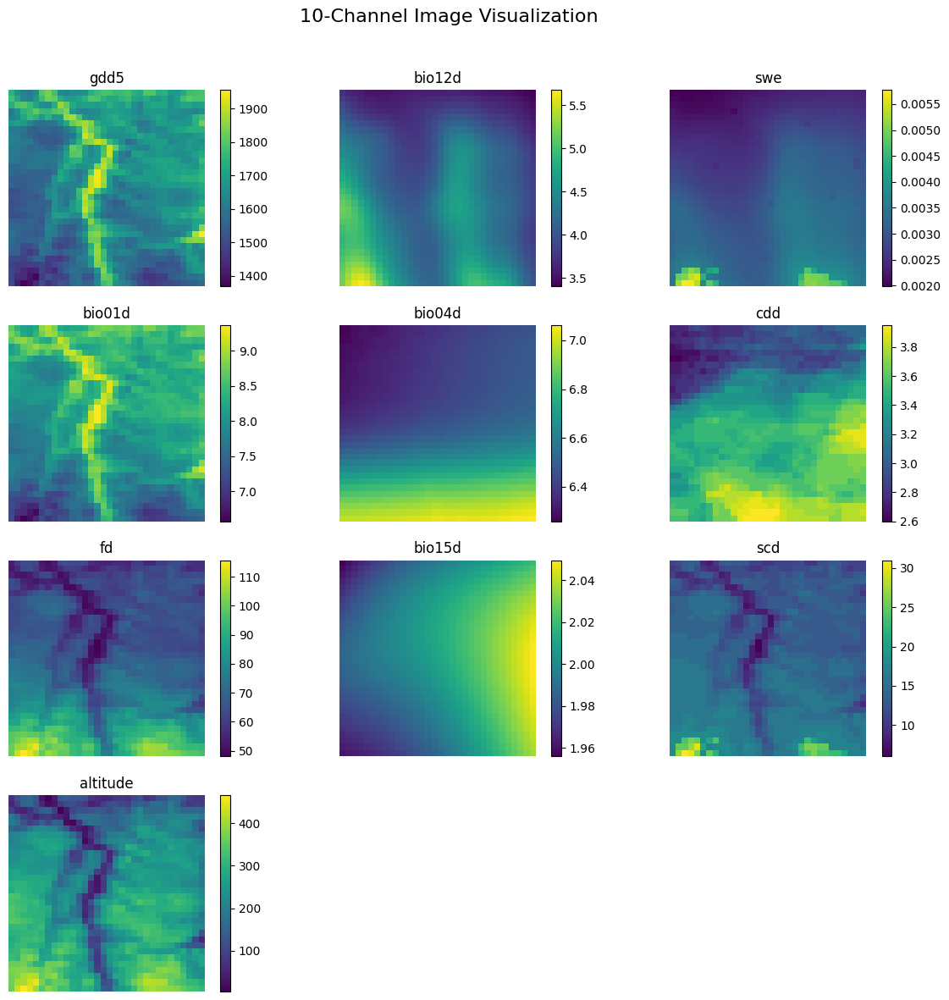

In [13]:
import numpy as np
import matplotlib.pyplot as plt

# Example 10-channel image (Replace with your actual data)
image_10ch = sampled_grids_climatic.iloc[44].climatic_map  # Shape (Height, Width, 10)

# Set up a 4-row, 3-column grid for 10 channels (12 slots total)
fig, axes = plt.subplots(4, 3, figsize=(12, 12))
fig.suptitle("10-Channel Image Visualization", fontsize=16)

# Flatten axes for easier indexing
axes = axes.flatten()

# Create a color map
cmap = plt.get_cmap("viridis")

# List of variable names
variable_names = variables.copy()  # Avoid modifying the original list
variable_names.append('altitude')  # Now length = 10

# Loop over the 10 channels
for i in range(10):
    ax = axes[i]
    img = ax.imshow(image_10ch[:, :, i], cmap=cmap)
    ax.set_title(f"{variable_names[i]}")
    ax.axis("off")
    fig.colorbar(img, ax=ax, orientation='vertical')

# Turn off the remaining unused subplots (slots 10 and 11)
for j in range(10, len(axes)):
    axes[j].axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
plt.show()


### Calculating species Richness

#### Loading Requirements

In [14]:
import json
import random

from tqdm import tqdm
import sys

import geopandas as gpd
from shapely.geometry import Point

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

# Import PyTorch
import torch
from torch import nn
import torch.optim as optim
import  torchvision.transforms as transforms

# Import torchvision 
import torchvision
from torchvision import datasets
from torchvision.transforms import ToTensor
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
from torchvision import models, transforms

In [15]:
seed = 42  # Choose any number

# Set seed for PyTorch
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)  # If using CUDA
torch.cuda.manual_seed_all(seed)  # If using multi-GPU
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# Set seed for NumPy and Python's random module
np.random.seed(seed)
random.seed(seed)

In [16]:
# Load from JSON file
with open(r"../data/species_universe_filtered_10.json", "r") as file:
    species_universe = json.load(file)

In [28]:
class MultiLabelDatasetRescale(Dataset):
    def __init__(self):
        # self.x_train, self.x_val, self.x_test, self.y_train, self.y_val, self.y_test = None, None, None, None, None, None
        self.mode = 'test'
        
         # Stack and convert to float32 tensor
        raw_images = torch.tensor(np.stack(df_2020_resampled['climatic_map'].values).astype(np.float32))  # shape: [N, H, W, C]
        # self.labels = torch.tensor(np.stack(df_2018_resampled['species_vector'].values).astype(np.float32))

        # Transpose to  [C, H, W] for PyTorch
        # raw_images = raw_images.permute(2, 0, 1)
        raw_images = raw_images.permute(0, 3, 1, 2)

                # === NORMALIZE EACH CHANNEL INDEPENDENTLY ===
        # These must match the order of your channels!

               # === NORMALIZE EACH CHANNEL INDEPENDENTLY ===
        # These must match the order of your channels!

        #2018
        # mins = torch.tensor([
        #     1.9000409841537476,          # gdd5
        #     0.9102739691734314,          # bio12d
        #     0.009359435178339481,         # swe
        #     -9.149993896484375,          # bio01d
        #     3.1500244140625,             # bio04d
        #     0.0,                         # cdd
        #     0.0,                         # fd
        #     1.0523613691329956,          # bio15d
        #     0.0,                         # scd
        #     0.0,                         # altitude
        # ])

        # maxs = torch.tensor([
        #     3858.301513671875, # gdd5
        #     21.650711059570312, #bio12d
        #     113.7122802734375, # swe
        #     10.45001220703125, #bio01d
        #     157.55001831054688, #bio04d
        #     8.0, #cdd
        #     362.0, # fd
        #     2.7762691974639893, #bio15d
        #     365.0, # scd
        #     2296.0, #altitude
        # ])

        # FUTURE HIRHAM5 2060-2080

        mins = torch.tensor([
            1.9000409841537476,          # gdd5
            0.9102739691734314,          # bio12d
            0.009359435178339481,         # swe
            -9.149993896484375,          # bio01d
            3.1500244140625,             # bio04d
            0.0,                         # cdd
            0.0,                         # fd
            1.0523613691329956,          # bio15d
            0.0,                         # scd
            0.0,                         # altitude
        ])

        maxs = torch.tensor([
            3858.301513671875, # gdd5
            21.650711059570312, #bio12d
            113.7122802734375, # swe
            11.1300, #bio01d
            157.55001831054688, #bio04d
            8.0, #cdd
            362.0, # fd
            2.7762691974639893, #bio15d
            365.0, # scd
            2296.0, #altitude
        ])
        

        # Avoid division by zero (e.g., for crs with constant 0)
        ranges = maxs - mins
        ranges[ranges == 0] = 1  # Prevent division by zero

        # Apply scaling: (x - min) / (max - min)
        # self.images = (raw_images - mins.view(-1, 1, 1)) / ranges.view(-1, 1, 1)

        
        self.images = (raw_images - mins.view(1, -1, 1, 1)) / ranges.view(1, -1, 1, 1)
        self.idx = df_2020_resampled.index.to_list()
        
    def __len__(self):
        if self.mode == 'test':
            
            return len(self.images)


    def __getitem__(self, idx):
        if self.mode == 'test':
            sample = {'images': self.images[idx], 'index': self.idx[idx]}

        return sample

In [29]:
import torch.nn.functional as F
import torch.distributed as dist
import argparse

class CustomLoss(nn.Module):
    def __init__(self, loss_fn, args):
        super(CustomLoss, self).__init__()
        self.loss_fn = loss_fn
        self.weighted = args.weighted
        self.args = args
        if self.weighted:
            self.samples_per_cls = list(args.train_label_cnt.values())
            self.no_of_classes = args.num_classes

    def compute_weights(self, labels, beta=0.9999):
        effective_num = 1.0 - np.power(beta, self.samples_per_cls)
        weights = (1.0 - beta) / np.array(effective_num)
        weights = weights / weights.sum() * self.no_of_classes
        labels_one_hot = labels

        weights = torch.tensor(weights).float().to(self.args.device, non_blocking=True)
        weights = weights.unsqueeze(0)
        weights = weights.repeat(labels_one_hot.shape[0],1) * labels_one_hot
        
        return weights
    
    def forward_focal(self, logits, labels,alpha=0.999,gamma=2.0):
        p = torch.sigmoid(logits)
        ce_loss = F.binary_cross_entropy_with_logits(logits, labels, reduction="none")
        p_t = p * labels + (1 - p) * (1 - labels)
        loss = ce_loss * ((1 - p_t) ** gamma)
        
        if self.weighted:
            weights = self.compute_weights(labels)
            weights_t = weights * labels * alpha + (1 - labels) * (1 - alpha)
            weighted_loss = weights_t * loss
            focal_loss = weighted_loss.mean()
        
        else:
            alpha_t = alpha * labels + (1 - alpha) * (1 - labels)
            focal_loss = alpha_t * loss
            focal_loss = focal_loss.mean()
        
        return focal_loss

    
    def forward_bce(self, logits, labels):
        if self.weighted:
            weights = self.compute_weights(labels)
            bce_loss = F.binary_cross_entropy_with_logits(logits, labels, pos_weight = weights)
        else:
            bce_loss = F.binary_cross_entropy_with_logits(logits, labels)
        
        return bce_loss
    
    
    def forward_dice(self, logits, labels):
        p = torch.sigmoid(logits)
        smooth = 1.0
        intersection = (p * labels).sum(0)
        total = (p**2 + labels**2).sum(0)
        dice_loss = 1 - (intersection + smooth)/(total + smooth)
        
        return dice_loss.mean()
    
    
    def forward(self, logits, labels):
        if self.loss_fn == 'bce':
            return self.forward_bce(logits, labels)
        elif self.loss_fn == 'focal':
            return self.forward_focal(logits, labels)
        elif self.loss_fn == 'dice':
            return self.forward_dice(logits, labels)

In [30]:
class CustomResNet18(nn.Module):
    def __init__(self, num_classes):
        super(CustomResNet18, self).__init__()

        # Load Pretrained ResNet18
        self.resnet = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)
        
        # Replace ReLU activations with inplace=False to avoid in-place modification issues
        # self.resnet.relu = nn.ReLU(inplace=False)

        # Modify the first convolutional layer to accept 11 channels instead of 3
        self.resnet.conv1 = nn.Conv2d(10, 64, kernel_size=7, stride=2, padding=3, bias=False)

        # Access layers up to the last block of layer4
        # self.features_conv = self.resnet.layer4[-1]  # Excluding the last block in layer4
        self.hook = self.resnet.layer3[-1].conv2.register_forward_hook(self.hook_fn)
        self.activations = None

        # Modify the final fully connected layer to match the number of classes     
        self.in_features = self.resnet.fc.in_features
        self.resnet.fc = nn.Linear(self.in_features, num_classes)

        # Freeze all layers initially
        for param in self.resnet.parameters():
            param.requires_grad = False

        # Placeholder for gradients
        self.gradients = None

    # Hook for capturing gradients during backward pass
    def activations_hook(self, grad):
        self.gradients = grad
        
    def hook_fn(self, module, input, output):
        # Store activations from the last convolutional layer
        self.activations = output
        
    # Forward pass through the network
    def forward(self, x):
        # Pass through the layers until the last convolutional block
        x = self.resnet.conv1(x)
        x = self.resnet.bn1(x)
        x = self.resnet.relu(x)
        x = self.resnet.maxpool(x)

        # Register the hook on the output of the last convolutional layer (conv2 of the last block)
        x = self.resnet.layer1(x)
        x = self.resnet.layer2(x)
        x = self.resnet.layer3(x)
        x = self.resnet.layer4(x)
        
        # Register hook on the output of the last convolutional layer in layer4[1]
        x.requires_grad_()  # Enable gradient computation for this tensor
        h = x.register_hook(self.activations_hook)
        
        # Continue through the network
        x = self.resnet.avgpool(x)
        x = torch.flatten(x, 1)
        x = self.resnet.fc(x)
        
        return x
    
    def get_embedding(self, x):
        # Forward pass up to avgpool
        x = self.resnet.conv1(x)
        x = self.resnet.bn1(x)
        x = self.resnet.relu(x)
        x = self.resnet.maxpool(x)

        x = self.resnet.layer1(x)
        x = self.resnet.layer2(x)
        x = self.resnet.layer3(x)
        x = self.resnet.layer4(x)

        x = self.resnet.avgpool(x)
        x = torch.flatten(x, 1)  # Shape: [batch_size, 2048]
        return x
    
    # Method to get the captured gradients
    def get_activations_gradient(self):
        return self.gradients

    # Method to get activations from the last convolutional layer (optional)
    def get_activations(self):
        return self.activations
    

#### Evaluating the model

In [31]:
# Load the NumPy array from the pickle file
# with open('../models/old_no_norm/thresholds_focal_RESNET18_49_tss_2017.pkl', 'rb') as f:
#     loaded_thresholds = pickle.load(f)

with open('../models/thresholds_FOCAL_RESNET18_55_tss_1991-2018_FUTURE_full.pkl', 'rb') as f:
    loaded_thresholds = pickle.load(f)
global_threshold = np.mean(loaded_thresholds[np.isfinite(loaded_thresholds)])
global_threshold
# with open('../models/thresholds_BCE_60_tss.pkl', 'rb') as f:
#     loaded_thresholds = pickle.load(f)

0.5155476

In [32]:
PATH = '../models/RESNET18_55_FOCAL_tss_1991-2018_FUTURE_full'
# PATH = '../models/old_no_norm/RESNET18_49_tss_2017'

In [33]:
num_classes = 1819
# device = torch.device('cuda:0')
device = torch.device('cuda:0')
MODEL = CustomResNet18(num_classes=num_classes).to(device)
# MODEL = CNNModel_1(11,32,num_classes).to(device)

# MODEL.load_state_dict(torch.load(PATH, weights_only=True)) # if GPU is available


MODEL.load_state_dict(torch.load(PATH, weights_only=True, map_location=torch.device(device)))
# model.to(args.device) 
MODEL.eval()

CustomResNet18(
  (resnet): ResNet(
    (conv1): Conv2d(10, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, tr

In [34]:
with open('../data/species_counts_filtered_10_1991_2017.json', 'r') as f:
    class_counts_dict = json.load(f)

In [35]:
# Example args (you can replace it with your actual arguments)
class Args:
    def __init__(self):
        self.weighted = True  # Set to False if no class weighting is needed
        self.train_label_cnt = class_counts_dict  # Example class counts
        self.num_classes = 1819  # Binary classification
        self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        self.model_type = 'CNN'
        self.eval = False
        # self.thres_method = 'adaptive'
        self.thres_method = 'global'
        self.threshold = global_threshold

In [36]:
# Function to set the seed for each worker
def seed_worker(worker_id):
    # Set seed for Python and NumPy in each worker
    worker_seed = torch.initial_seed() % 2**32
    np.random.seed(worker_seed)
    random.seed(worker_seed)

In [37]:
with open(r'../data/Full_Scale/sampled_grids_bin_008_rcp85_2021-2040.pkl', "rb") as file_2:
    df_2020_resampled = pickle.load(file_2)
df_2020_resampled

,geometry,latitude,longitude,climatic_map
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1758.7927, 3.2801259, 0.0020838708, 8.87809..."
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1763.3402, 3.2660127, 0.0021193547, 8.88915..."
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1765.6877, 3.1643784, 0.0021612903, 8.88563..."
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1762.6427, 3.1806505, 0.0019935484, 8.84614..."
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1760.6477, 3.1769516, 0.0019548386, 8.81201..."
...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[702.694, 2.9083018, 0.0072376467, 2.4201298..."
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[715.23895, 2.864912, 0.0071916915, 2.423759..."
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[752.344, 3.0350068, 0.0077629993, 2.6749468..."
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[688.43146, 3.0094373, 0.007964349, 2.084159..."


In [38]:

args = Args()
mlc_dataset = MultiLabelDatasetRescale()

print(len(mlc_dataset))
# mlc_dataset.train_val_test_split()
dataloader = DataLoader(mlc_dataset, batch_size = 32, shuffle = False, worker_init_fn=seed_worker)

11470


In [39]:
def species_vectors(model, eval_loader, criterion, thresholds, args):
    model.eval()
    # eval_loss = []
    all_preds = {}

    with torch.no_grad():
        for batch in eval_loader:
            samples = batch['images'].to(args.device, non_blocking=True)
            # targets = batch['labels'].to(args.device, non_blocking=True)
            index = batch['index'].to(args.device, non_blocking=True)
            
            outputs = model(samples)
            # loss = criterion(outputs, targets)
            # eval_loss.append(loss.item())

            # Threshold logic
            if args.thres_method == 'adaptive':
                thresholds_tensor = torch.tensor(thresholds, dtype=torch.float32).to(args.device)
            elif args.thres_method == 'global':
                thresholds_tensor = torch.tensor([args.threshold] * outputs.shape[1], dtype=torch.float32).to(args.device)
            else:
                raise ValueError("Unknown threshold method")

            probs = torch.sigmoid(outputs)
            preds = (probs >= thresholds_tensor).float()

            # Append each prediction individually to the list
            for i, pred in zip(index, preds):
                index_number = i.item()

                # print(index_number)
                all_preds[index_number] = pred.cpu().numpy()

    return all_preds

In [40]:
prob_dic = species_vectors(model = MODEL,eval_loader = dataloader, criterion = CustomLoss('focal', args), thresholds = loaded_thresholds, args = Args())


In [41]:
# Wrap each vector in a list so it stays in a single column
preds_df = pd.DataFrame({
    "predicted_vector": [v for v in prob_dic.values()]
}, index=prob_dic.keys())
preds_df

,predicted_vector
0,"[0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
1,"[0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
2,"[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
3,"[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
4,"[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
...,...
11465,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ..."
11466,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ..."
11467,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ..."
11468,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ..."


In [42]:
df_2020_with_preds = df_2020_resampled.join(preds_df, how='left')
df_2020_with_preds

,geometry,latitude,longitude,climatic_map,predicted_vector
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1758.7927, 3.2801259, 0.0020838708, 8.87809...","[0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1763.3402, 3.2660127, 0.0021193547, 8.88915...","[0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1765.6877, 3.1643784, 0.0021612903, 8.88563...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1762.6427, 3.1806505, 0.0019935484, 8.84614...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1760.6477, 3.1769516, 0.0019548386, 8.81201...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ..."
...,...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[702.694, 2.9083018, 0.0072376467, 2.4201298...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ..."
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[715.23895, 2.864912, 0.0071916915, 2.423759...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ..."
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[752.344, 3.0350068, 0.0077629993, 2.6749468...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ..."
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[688.43146, 3.0094373, 0.007964349, 2.084159...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ..."


In [43]:
def calculate_sp_richness(species_vectors):
    richness = []
    for i in species_vectors:
        nonzero = np.count_nonzero(i)
        richness.append(nonzero)
    return richness
# df_2018_with_preds['true_richness'] = calculate_sp_richness(df_2018_with_preds['species_vector'])    
df_2020_with_preds['predicted_richness'] = calculate_sp_richness(df_2020_with_preds['predicted_vector'])    
df_2020_with_preds

,geometry,latitude,longitude,climatic_map,predicted_vector,predicted_richness
0,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1758.7927, 3.2801259, 0.0020838708, 8.87809...","[0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",687
1,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1763.3402, 3.2660127, 0.0021193547, 8.88915...","[0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",701
2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1765.6877, 3.1643784, 0.0021612903, 8.88563...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",747
3,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1762.6427, 3.1806505, 0.0019935484, 8.84614...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",734
4,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1760.6477, 3.1769516, 0.0019548386, 8.81201...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",733
...,...,...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[702.694, 2.9083018, 0.0072376467, 2.4201298...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...",248
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[715.23895, 2.864912, 0.0071916915, 2.423759...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...",235
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[752.344, 3.0350068, 0.0077629993, 2.6749468...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...",227
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[688.43146, 3.0094373, 0.007964349, 2.084159...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...",253


In [45]:
def points_species_richness_plot(df, column_name):
    # Load the shapefile of Norway's boundaries
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)  # Make sure it's in EPSG:4326 for plotting
    
    # Assuming 'df' contains your data with species richness in 'column_name' column
    # Step 1: Create GeoDataFrame from the DataFrame
    result_geo_df = gpd.GeoDataFrame(
        df, 
        geometry=gpd.points_from_xy(df.longitude, df.latitude),
        crs="EPSG:4326"  # Ensure the correct CRS
    )
     # ✅ Create new figure and axis
    fig, ax = plt.subplots(figsize=(8, 10))
    # Step 2: Plot the map
    # Plot the Norway boundary
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    
    # Step 3: Plot the points with species richness as colors
    result_geo_df.plot(
        ax=ax, 
        column=column_name,  # Use the column passed to the function
        cmap='YlGnBu',  # Colormap for heatmap, you can try others like 'viridis', 'plasma', etc.
        markersize=3, 
        legend=True,  # Add legend for color scale
        alpha=0.7  # Make points slightly transparent for better visualization
    )
    
    # Customize plot
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.set_title(f"Predicted_Species_Richness_in_Norway_2021-2040", fontsize=15)
    plt.tight_layout()
    plt.savefig('../Images/SpeciesRichness_11000_samples_2021-2040.png')
    # Show the plots
    plt.show()

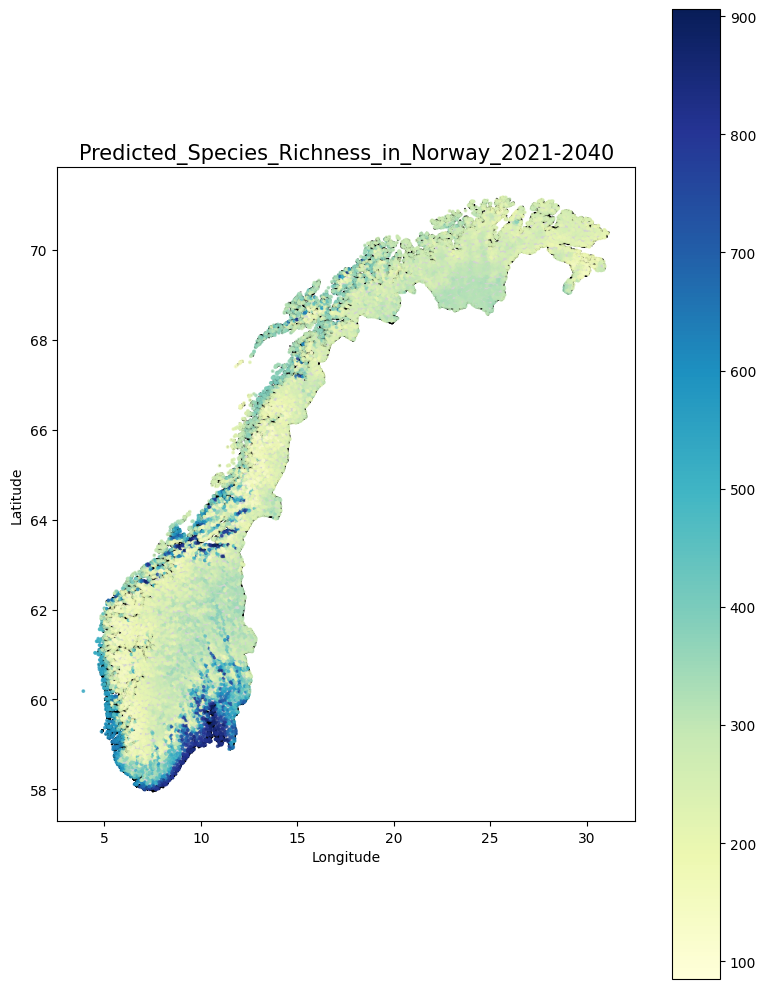

In [46]:
# Plot the predicted richness on the second subplot
points_species_richness_plot(df=df_2020_with_preds, column_name='predicted_richness')

### Redlisted SP Richness

In [47]:
# !pip install openpyxl
df_redlist = pd.read_excel(r'../data/interesting species.xlsx')
df_redlist

,Vitenskapelig navn,Autor,Populærnavn,Taksonomisk nivå,Kategori 2021,Distribution
0,Anacamptis morio,"(L.) R.M.Bateman, Pridgeon & M.W.Chase",narrmarihand,Art,CR,NaN
1,Anisantha sterilis,(L.) Nevski,sandfaks,Art,CR,NaN
2,Asperula tinctoria,L.,fargemyske,Art,CR,NaN
3,Blysmus compressus,(L.) Panz. ex Link,flatsivaks,Art,CR,NaN
4,Botrychium matricariifolium,(Retz.) A.Braum ex W.D.J.Koch,huldrenøkkel,Art,CR,NaN
...,...,...,...,...,...,...
1371,Berula erecta,(Huds.) Coville,vasskjeks,Art,VU,NaN
1372,Beta vulgaris,L.,bete,Art,VU,NaN
1373,Glaucium flavum,Crantz,gul hornvalmue,Art,VU,NaN
1374,Kali turgida,(Dumort.) Gutermann,sodaurt,Art,VU,NaN


In [48]:
# Filter rows where 'Kategori 2021' is CR, EN, or VU
redlisted_sp_df = df_redlist[df_redlist['Kategori 2021'].isin(['CR', 'EN', 'VU'])]
redlisted_species_list = redlisted_sp_df['Vitenskapelig navn'] 
redlisted_sp_df

,Vitenskapelig navn,Autor,Populærnavn,Taksonomisk nivå,Kategori 2021,Distribution
0,Anacamptis morio,"(L.) R.M.Bateman, Pridgeon & M.W.Chase",narrmarihand,Art,CR,NaN
1,Anisantha sterilis,(L.) Nevski,sandfaks,Art,CR,NaN
2,Asperula tinctoria,L.,fargemyske,Art,CR,NaN
3,Blysmus compressus,(L.) Panz. ex Link,flatsivaks,Art,CR,NaN
4,Botrychium matricariifolium,(Retz.) A.Braum ex W.D.J.Koch,huldrenøkkel,Art,CR,NaN
...,...,...,...,...,...,...
1371,Berula erecta,(Huds.) Coville,vasskjeks,Art,VU,NaN
1372,Beta vulgaris,L.,bete,Art,VU,NaN
1373,Glaucium flavum,Crantz,gul hornvalmue,Art,VU,NaN
1374,Kali turgida,(Dumort.) Gutermann,sodaurt,Art,VU,NaN


In [50]:
def points_redlisted_species_richness_plot(df, redlisted_species, species_universe):
    # Step 1: Get indices of redlisted species
    redlisted_indices = [species_universe[sp] for sp in redlisted_species if sp in species_universe]

    # Step 2: Compute red-listed richness per point
    df = df.copy()
    df["redlisted_richness"] = df["predicted_vector"].apply(
        lambda x: sum(x[i] for i in redlisted_indices)
    )

    # Step 3: Remove points with 0 redlisted richness
    df = df[df["redlisted_richness"] > 0]

    # Step 4: Make GeoDataFrame
    gdf = gpd.GeoDataFrame(
        df,
        geometry=gpd.points_from_xy(df.longitude, df.latitude),
        crs="EPSG:4326"
    )

    # Step 5: Plotting
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)
    fig, ax = plt.subplots(figsize=(8, 10))
    norway.plot(ax=ax, color="lightgray", edgecolor="black")

    gdf.plot(
        ax=ax,
        column="redlisted_richness",
        cmap="Reds",
        markersize=3,
        legend=True,
        alpha=0.7
    )

    ax.set_title("Red-listed Species Richness in Norway 2021-2040", fontsize=14)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    plt.tight_layout()
    plt.savefig(f"../Images/2021-2040 redlist sp in Norway.png")
    plt.show()


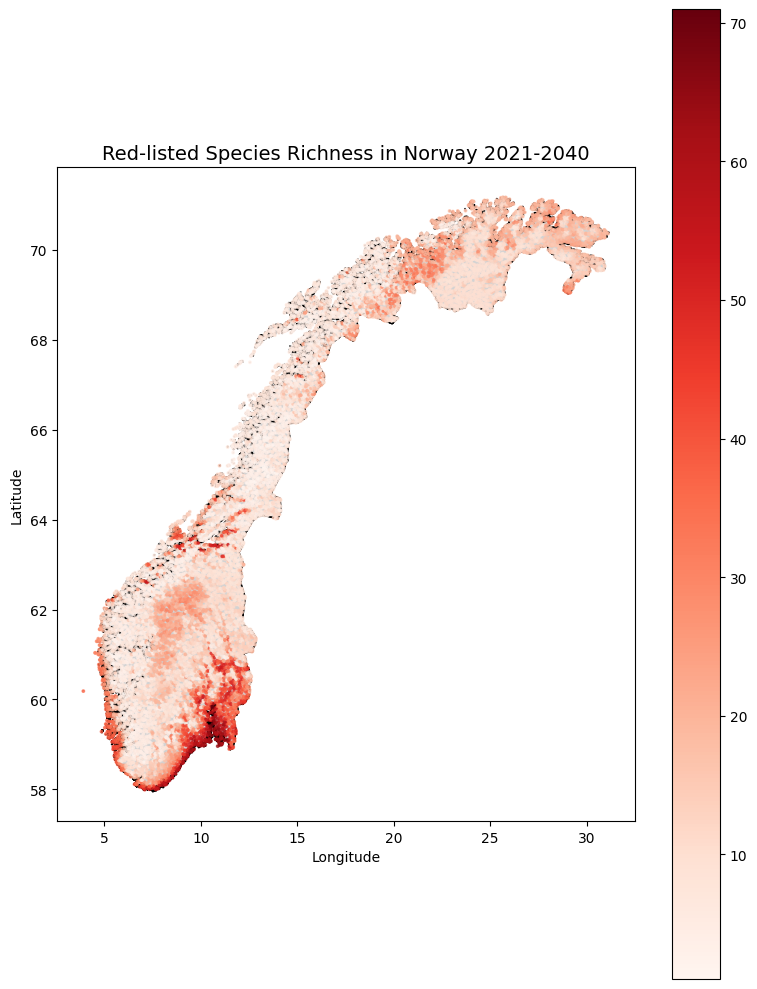

In [51]:
points_redlisted_species_richness_plot(df_2020_with_preds, redlisted_species_list, species_universe)

### Clustering Logits

In [52]:
# !pip install umap-learn
import umap.umap_ as umap
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

In [53]:
def umap_logits(model, eval_loader): 
    all_embeddings = []
    # all_labels = []
    all_indexes = []
    model.eval()
    with torch.no_grad():
        # for data, targets in tqdm(eval_loader, file=sys.stdout):
        for batch in eval_loader:
            samples = batch['images'].to(args.device, non_blocking=True)
            # labels = batch['labels'].to(args.device, non_blocking=True) 
            indexes = batch['index'].to(args.device, non_blocking=True)
            embeddings = model.get_embedding(samples)
            all_embeddings.append(embeddings.cpu().numpy())
            # all_labels.append(labels.cpu().numpy())
            all_indexes.append(indexes.cpu().numpy())
    # Convert to arrays
    X = np.vstack(all_embeddings)  # Shape: [N_samples, 2048]
    # y = np.concatenate(all_labels)
    ind = np.concatenate(all_indexes)
    reducer = umap.UMAP(n_components=3, random_state=42)
    X_umap = reducer.fit_transform(X)

    return X_umap, ind

In [54]:
umap, ind = umap_logits(model = MODEL,eval_loader = dataloader)

C:\Users\Raul\miniconda3\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


In [55]:
ind

array([    0,     1,     2, ..., 11467, 11468, 11469], dtype=int64)

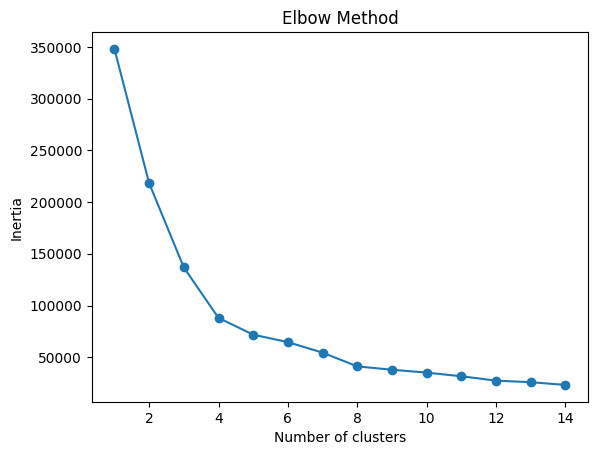

In [56]:
# Optional: Elbow method
inertia = []
for k in range(1, 15):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(umap)
    inertia.append(kmeans.inertia_)

plt.plot(range(1, 15), inertia, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.title('Elbow Method')
plt.show()

In [57]:
number_clusters = 6

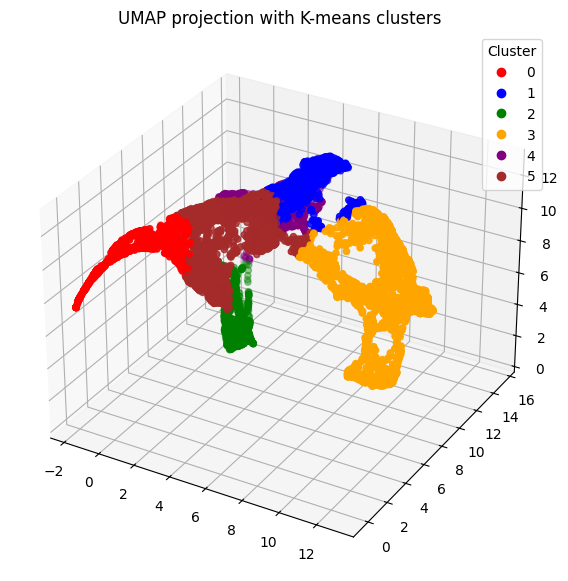

In [58]:
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import ListedColormap

# Fixed color map
fixed_colors = ['red', 'blue', 'green', 'orange', 'purple', 'brown', 'pink', 'gray', 'olive', 'cyan']
fixed_cmap = ListedColormap(fixed_colors[:number_clusters])
# Final model with chosen K
kmeans = KMeans(n_clusters=number_clusters, random_state=42)
clusters = kmeans.fit_predict(umap)

fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(umap[:, 0], umap[:, 1], umap[:, 2],
                     c=clusters, cmap=fixed_cmap, s=20)
ax.set_title("UMAP projection with K-means clusters")
plt.legend(*scatter.legend_elements(), title="Cluster")
plt.savefig(f"../Images/k-means_2060-2080.png")
plt.show()


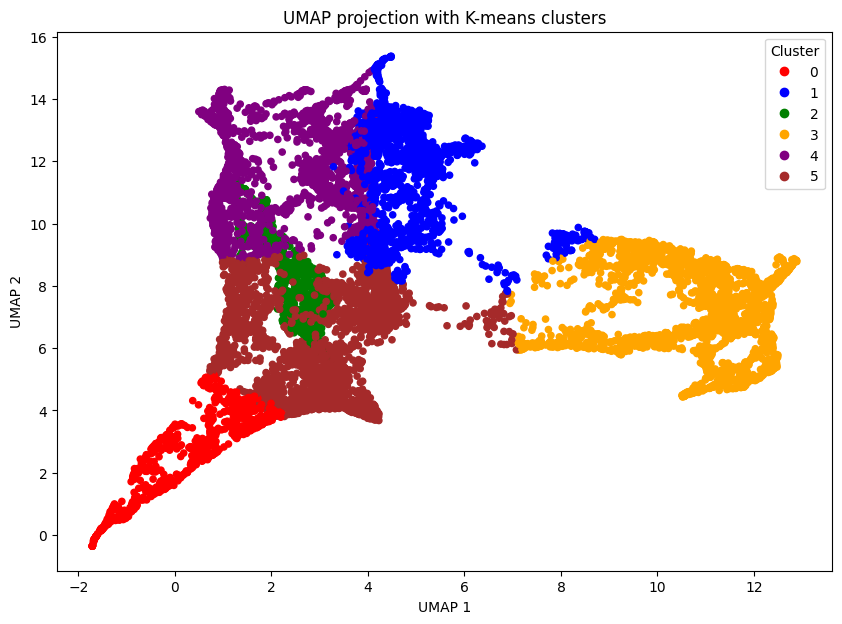

In [59]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans

# Final model with chosen K
kmeans = KMeans(n_clusters=number_clusters, random_state=42)
clusters = kmeans.fit_predict(umap)

# 2D Plot
plt.figure(figsize=(10, 7))
scatter = plt.scatter(umap[:, 0], umap[:, 1],
                      c=clusters, cmap=fixed_cmap, s=20)
plt.title("UMAP projection with K-means clusters")
plt.legend(*scatter.legend_elements(), title="Cluster")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
plt.show()


In [60]:
# Creating umap DF
df_umap = pd.DataFrame(umap, columns=["UMAP1", "UMAP2", "UMAP3"])
df_umap["index"] = ind
df_umap["Cluster"] = clusters

In [61]:

import plotly.graph_objs as go

# Crear figura base
fig = go.Figure(
    data=[go.Scatter3d(
        x=df_umap["UMAP1"],
        y=df_umap["UMAP2"],
        z=df_umap["UMAP3"],
        mode='markers',
        marker=dict(
            size=3,
            color=df_umap["Cluster"],  # Numérico
            colorscale='Viridis',
            opacity=0.8
        ),
        text=df_umap["Cluster"].astype(str),
    )]
)

# Configuración general
fig.update_layout(
    scene=dict(
        xaxis_title='UMAP1',
        yaxis_title='UMAP2',
        zaxis_title='UMAP3'
    ),
    title="UMAP 3D with KMeans Clusters",
    margin=dict(l=0, r=0, b=0, t=30),
)

# No se agregan los frames ni la animación de rotación

fig.show()

# Guardar la figura
# fig.write_html(r"../docs/umap_3d_plot_no_rotate.html")




### Plotting UMAP on MAP

In [62]:
df_2020_with_clusters = df_umap.merge(
    df_2020_with_preds,
    left_on='index',      # 'index' column in df_umap
    right_index=True,     # index in df_2018_with_preds
    how='left'
)
df_2020_with_clusters

,UMAP1,UMAP2,UMAP3,index,Cluster,geometry,latitude,longitude,climatic_map,predicted_vector,predicted_richness
0,1.452122,11.112280,3.411925,0,2,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1758.7927, 3.2801259, 0.0020838708, 8.87809...","[0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",687
1,1.453666,11.101028,3.411414,1,2,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1763.3402, 3.2660127, 0.0021193547, 8.88915...","[0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",701
2,1.464815,11.080525,3.327679,2,2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1765.6877, 3.1643784, 0.0021612903, 8.88563...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",747
3,1.467956,11.073444,3.325154,3,2,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1762.6427, 3.1806505, 0.0019935484, 8.84614...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",734
4,1.469239,11.067798,3.335072,4,2,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1760.6477, 3.1769516, 0.0019548386, 8.81201...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",733
...,...,...,...,...,...,...,...,...,...,...,...
11465,10.250861,9.212015,11.355360,11465,3,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[702.694, 2.9083018, 0.0072376467, 2.4201298...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...",248
11466,10.431097,9.056516,11.230375,11466,3,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[715.23895, 2.864912, 0.0071916915, 2.423759...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...",235
11467,10.478789,9.180895,10.875160,11467,3,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[752.344, 3.0350068, 0.0077629993, 2.6749468...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...",227
11468,10.326864,9.118405,11.279179,11468,3,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[688.43146, 3.0094373, 0.007964349, 2.084159...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...",253


In [64]:
import matplotlib.pyplot as plt
import geopandas as gpd
import matplotlib.cm as cm
import matplotlib.colors as mcolors

def plotting_samples_norway_cluster(df):
    # Load Norway shapefile
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)

    # Create figure and axes
    fig, ax = plt.subplots(figsize=(10, 10))

    # Plot Norway outline
    norway.plot(ax=ax, color="lightgray", edgecolor="black")

    # Create GeoDataFrame
    result_geo_df = gpd.GeoDataFrame(
        df,
        geometry=gpd.points_from_xy(df.longitude, df.latitude),
        crs="EPSG:4326"
    )

    # Get sorted unique cluster labels
    clusters = sorted(result_geo_df["Cluster"].unique())

    # Get viridis colormap with N discrete colors
    cmap = fixed_cmap
    colors = [cmap(i) for i in range(len(clusters))]
    cluster_to_color = dict(zip(clusters, colors))

    # Plot each cluster with its color
    for cluster_label in clusters:
        cluster_df = result_geo_df[result_geo_df["Cluster"] == cluster_label]
        cluster_df.plot(
            ax=ax,
            markersize=3,
            label=f"Cluster {cluster_label}",
            color=cluster_to_color[cluster_label],
            alpha=0.8
        )

    # Customize plot
    ax.set_title("Clusterized Bioclimatic regions 2021-2040", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.legend(title="Cluster", loc="lower right", markerscale=6)
    plt.savefig(f"../Images/2021-2040_bioclimatic_regions_in_Norway.png")

    plt.show()


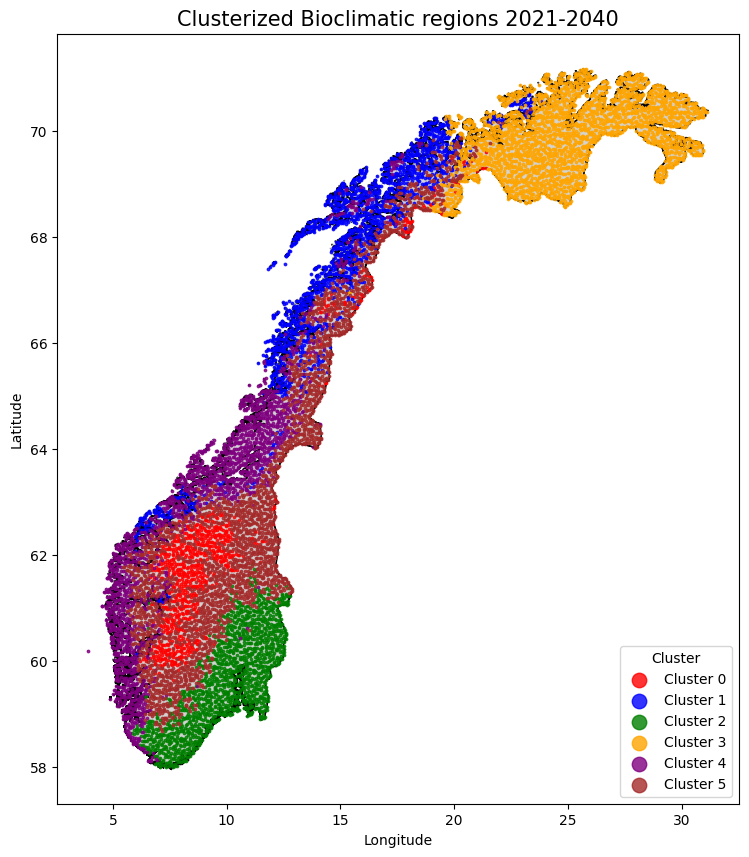

In [65]:
plotting_samples_norway_cluster(df_2020_with_clusters)

Est - west gradient is very strong due to the oceanic influence.

In [66]:
df_2020_with_clusters

,UMAP1,UMAP2,UMAP3,index,Cluster,geometry,latitude,longitude,climatic_map,predicted_vector,predicted_richness
0,1.452122,11.112280,3.411925,0,2,"MULTIPOLYGON (((7.0069 58.02409, 6.99014 58.02...",58.028287,6.997755,"[[[1758.7927, 3.2801259, 0.0020838708, 8.87809...","[0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",687
1,1.453666,11.101028,3.411414,1,2,"POLYGON ((7.0572 58.02726, 7.05918 58.01836, 7...",58.022171,7.050138,"[[[1763.3402, 3.2660127, 0.0021193547, 8.88915...","[0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",701
2,1.464815,11.080525,3.327679,2,2,"MULTIPOLYGON (((7.08188 57.99272, 7.0908 57.99...",57.990907,7.086381,"[[[1765.6877, 3.1643784, 0.0021612903, 8.88563...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",747
3,1.467956,11.073444,3.325154,3,2,"POLYGON ((7.2277 58.02503, 7.21074 58.02487, 7...",58.026571,7.219693,"[[[1762.6427, 3.1806505, 0.0019935484, 8.84614...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",734
4,1.469239,11.067798,3.335072,4,2,"POLYGON ((7.27722 58.03186, 7.294 58.03288, 7....",58.029728,7.285729,"[[[1760.6477, 3.1769516, 0.0019548386, 8.81201...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",733
...,...,...,...,...,...,...,...,...,...,...,...
11465,10.250861,9.212015,11.355360,11465,3,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[702.694, 2.9083018, 0.0072376467, 2.4201298...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...",248
11466,10.431097,9.056516,11.230375,11466,3,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[715.23895, 2.864912, 0.0071916915, 2.423759...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...",235
11467,10.478789,9.180895,10.875160,11467,3,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[752.344, 3.0350068, 0.0077629993, 2.6749468...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...",227
11468,10.326864,9.118405,11.279179,11468,3,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[688.43146, 3.0094373, 0.007964349, 2.084159...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...",253


In [67]:
import pandas as pd
import numpy as np

# Assuming 'df' is your DataFrame containing the data with the 'climatic_map' column

# Define a function to calculate the mean per channel
def extract_mean_climatic_map(df):
    # Initialize an empty list to store the results
    mean_values = []

    # Iterate over each row in the dataframe
    for idx, row in df.iterrows():
        # Flatten the climatic_map (assuming it's a list of lists of lists)
        climatic_map = np.array(row['climatic_map'])

        # Compute the mean of the values per channel (assuming each column in the map corresponds to a channel)
        mean_per_channel = climatic_map.mean(axis=(0, 1))  # Mean over the first two dimensions (rows and columns of the map)

        # Store the means for each row
        mean_values.append(mean_per_channel)
        
    variables_list =['gdd5', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd','alt']


    # Add the mean values as new columns to the dataframe
    mean_values_df = pd.DataFrame(mean_values, columns=[f"{variables_list[i]}" for i in range(mean_values[0].shape[0])])

    # Concatenate the new mean columns to the original dataframe (excluding 'geometry' column)
    df_with_means = pd.concat([df.drop(columns=['geometry']), mean_values_df], axis=1)
    return df_with_means

# Now group by Cluster and calculate the mean for each cluster
df_with_means = extract_mean_climatic_map(df_2020_with_clusters)

# Group by 'Cluster' and calculate the mean of each channel, excluding non-numeric columns
grouped_means = df_with_means.drop(columns=['index','latitude', 'longitude', 'predicted_vector', 'predicted_richness']).groupby('Cluster').mean()




In [68]:
df_with_means

,UMAP1,UMAP2,UMAP3,index,Cluster,latitude,longitude,climatic_map,predicted_vector,predicted_richness,gdd5,bio12d,swe,bio01d,bio04d,cdd,fd,bio15d,scd,alt
0,1.452122,11.112280,3.411925,0,2,58.028287,6.997755,"[[[1758.7927, 3.2801259, 0.0020838708, 8.87809...","[0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",687,1757.167969,3.721909,0.001541,8.869720,5.964570,3.075830,46.553837,1.868678,7.020508,39.381836
1,1.453666,11.101028,3.411414,1,2,58.022171,7.050138,"[[[1763.3402, 3.2660127, 0.0021193547, 8.88915...","[0.0, 1.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",701,1751.000854,3.656103,0.001654,8.824450,6.012110,3.001269,47.936890,1.886128,7.890625,39.798828
2,1.464815,11.080525,3.327679,2,2,57.990907,7.086381,"[[[1765.6877, 3.1643784, 0.0021612903, 8.88563...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",747,1747.364258,3.508085,0.001784,8.795703,6.045320,3.017921,48.930798,1.901798,8.525391,28.430664
3,1.467956,11.073444,3.325154,3,2,58.026571,7.219693,"[[[1762.6427, 3.1806505, 0.0019935484, 8.84614...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",734,1721.898438,3.574326,0.001937,8.618925,6.201097,2.874805,54.494728,1.944880,10.482422,62.408203
4,1.469239,11.067798,3.335072,4,2,58.029728,7.285729,"[[[1760.6477, 3.1769516, 0.0019548386, 8.81201...","[0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, ...",733,1724.826416,3.537834,0.002040,8.593241,6.276948,2.881052,56.437012,1.965514,10.928711,65.273438
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11465,10.250861,9.212015,11.355360,11465,3,71.160690,25.549503,"[[[702.694, 2.9083018, 0.0072376467, 2.4201298...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...",248,690.035034,2.691338,0.007158,2.146282,7.488858,1.244239,179.296967,1.664849,120.552734,70.623047
11466,10.431097,9.056516,11.230375,11466,3,71.160205,25.621730,"[[[715.23895, 2.864912, 0.0071916915, 2.423759...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...",235,692.936096,2.695601,0.007257,2.109823,7.544868,1.199757,180.128067,1.677820,120.732422,82.509766
11467,10.478789,9.180895,10.875160,11467,3,71.175275,25.662772,"[[[752.344, 3.0350068, 0.0077629993, 2.6749468...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...",227,692.934692,2.639648,0.007210,2.074655,7.579624,1.205520,180.866364,1.691128,121.132812,73.997070
11468,10.326864,9.118405,11.279179,11468,3,71.166685,25.790593,"[[[688.43146, 3.0094373, 0.007964349, 2.084159...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, ...",253,698.954590,2.665901,0.007358,2.038539,7.660596,1.117141,181.737259,1.690314,121.399414,64.622070


In [69]:
# Show the result
grouped_means

,UMAP1,UMAP2,UMAP3,climatic_map,gdd5,bio12d,swe,bio01d,bio04d,cdd,fd,bio15d,scd,alt
Cluster,,,,,,,,,,,,,,
0,0.238433,2.537421,10.083809,"[[[565.81464, 4.313627, 0.014493467, 0.0514604...",560.808838,4.196239,0.013797,-0.022171,8.265906,1.417996,222.898346,1.541896,167.969696,1145.146484
1,4.879352,11.633576,11.447924,"[[[828.0004, 5.32061, 0.009054867, 2.6081011, ...",829.850708,5.258133,0.008758,2.666043,7.987993,1.381861,170.065887,1.580964,97.014114,198.596634
2,2.365194,8.273164,3.479427,"[[[1619.1265, 3.057216, 0.0043936637, 6.776444...",1579.900879,3.077802,0.004698,6.502656,8.284942,3.959330,123.855148,2.108723,68.057846,317.038239
3,10.739304,7.136467,8.737962,"[[[707.10596, 2.290669, 0.00557738, 0.5471834,...",697.355469,2.339214,0.005715,0.588868,9.048199,1.202330,204.126266,1.805915,149.357635,319.424103
4,2.475820,11.735073,8.949327,"[[[1112.6428, 6.02471, 0.008696033, 5.184864, ...",1102.427612,6.116686,0.009096,5.121357,6.894547,1.702854,127.650444,1.549592,65.654251,253.857712
5,3.057872,6.136783,9.496971,"[[[804.2704, 4.7130423, 0.012806676, 1.9390785...",785.989746,4.715158,0.013043,1.819994,8.358779,1.574795,194.756546,1.637769,140.642456,766.262024


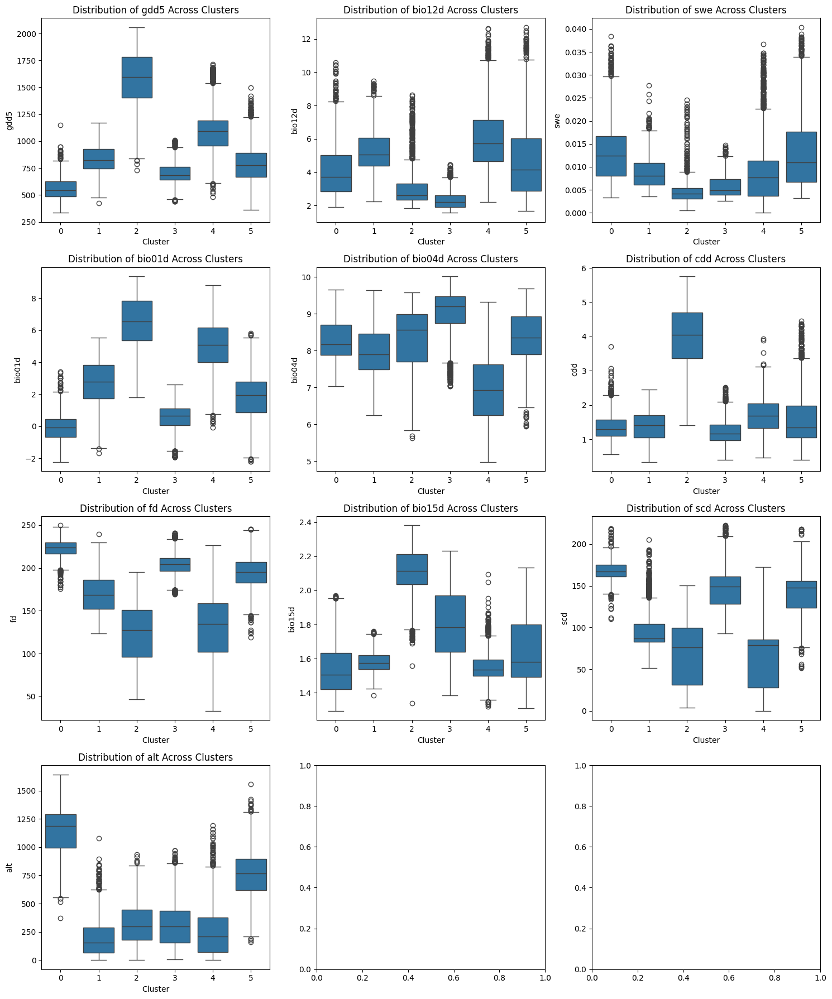

In [70]:
# List of variables
variables = ['gdd5', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd', 'alt']

# Create a figure and axes for the boxplots
fig, axes = plt.subplots(4, 3, figsize=(15, 18))  # 4 rows and 3 columns for a total of 12 plots
axes = axes.flatten()  # Flatten to easily index the axes

# Loop over each variable and create a boxplot
for i, var in enumerate(variables):
    sns.boxplot(x='Cluster', y=var, data=df_with_means, ax=axes[i])
    axes[i].set_title(f'Distribution of {var} Across Clusters')
    axes[i].set_xlabel('Cluster')
    axes[i].set_ylabel(var)

# Adjust layout
plt.tight_layout()
plt.show()

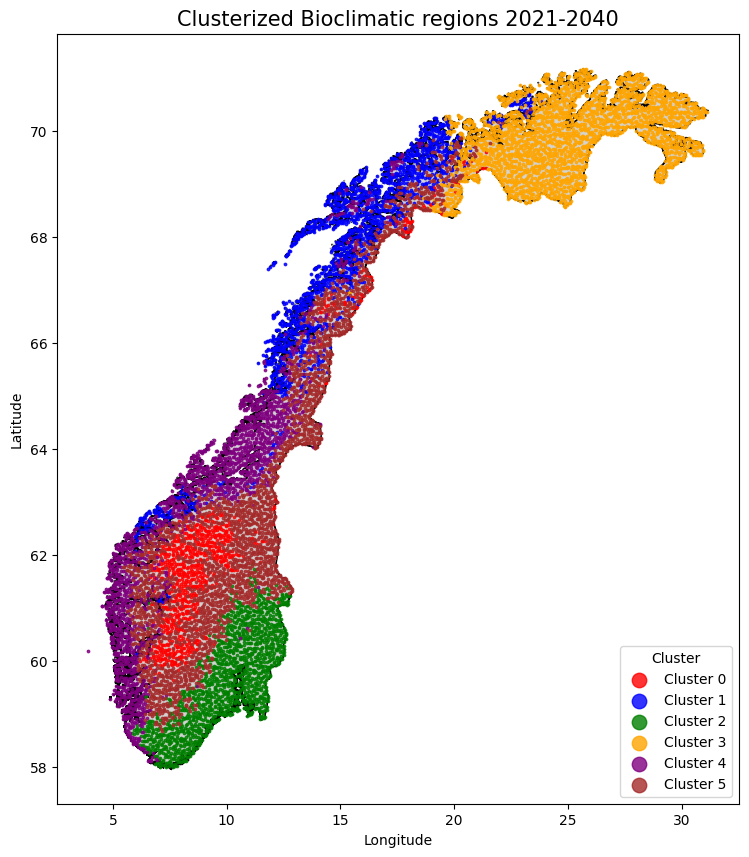

In [71]:
plotting_samples_norway_cluster(df_2020_with_clusters)

### Integrated Gradients

In [48]:
# Load from JSON file
with open(r"../data/species_universe_filtered_10.json", "r") as file:
    species_universe = json.load(file)
# Filter for Salix species and get their indexes
salix_indexes = {species: index for species, index in species_universe.items() if species.lower().startswith('salix')}

# Show the result
print(salix_indexes)

{'Salix myrsinifolia': 175, 'Salix polaris': 243, 'Salix myrtilloides': 411, 'Salix phylicifolia': 419, 'Salix smithiana': 569, 'Salix lanata': 656, 'Salix viminalis': 663, 'Salix arbuscula': 739, 'Salix pentandra': 786, 'Salix daphnoides': 793, 'Salix hastata': 838, 'Salix gmelinii': 847, 'Salix starkeana': 912, 'Salix caprea': 987, 'Salix lapponum': 996, 'Salix reticulata': 1060, 'Salix myrsinites': 1176, 'Salix meyeriana': 1222, 'Salix alba': 1257, 'Salix repens': 1337, 'Salix fragilis': 1341, 'Salix purpurea': 1417, 'Salix glauca': 1510, 'Salix triandra': 1553, 'Salix cinerea': 1559, 'Salix aurita': 1730, 'Salix herbacea': 1795}


In [53]:
def extract_position(model, eval_loader, name, criterion,thresholds,args): 
    selected_images = []
    sp_index = species_universe[name]
    # eval_loss = []
    model.eval()
    with torch.no_grad():
        # for data, targets in tqdm(eval_loader, file=sys.stdout):
        for batch in eval_loader:
            samples = batch['images'].to(args.device, non_blocking=True)
            outputs = model(samples)
                
            # targets = batch['labels'].to(args.device, non_blocking=True)            
            # loss = criterion(outputs, targets)
            # eval_loss.append(loss.item())
            
            if args.thres_method == 'adaptive':
                # thresholds = torch.load(args.output_dir.joinpath('thresholds_train.pth'))
                thresholds = torch.tensor(thresholds, dtype=torch.float32).to(args.device)
                # thresholds = torch.tensor(thresholds).to(args.device)
            elif args.thres_method == 'global':
                thresholds = args.threshold
            
            prob = torch.sigmoid(outputs) >= thresholds
            # label = targets >= thresholds
            
            # print('prob',prob)
            # print('prob shape',prob.shape)

            # print('label',label)
            # print(samples.shape[0])
            # Go through the batch
            for i in range(samples.shape[0]):
                if prob[i][sp_index]:
                    selected_images.append(samples[i].cpu())  



        # eval_loss = torch.tensor(eval_loss).mean().item()

        return selected_images
    

In [54]:
selected_images = extract_position(model = MODEL,eval_loader = dataloader,
                          name = 'Salix reticulata', 
                          criterion = CustomLoss('focal', args), 
                          thresholds = loaded_thresholds, 
                          args = Args())

In [55]:
len(selected_images),selected_images

(5522,
 [tensor([[[0.3044, 0.2792, 0.2605,  ..., 0.2236, 0.2174, 0.2121],
           [0.3130, 0.2938, 0.2828,  ..., 0.2255, 0.2191, 0.2163],
           [0.3183, 0.2952, 0.2719,  ..., 0.2305, 0.2315, 0.2287],
           ...,
           [0.1893, 0.1875, 0.1796,  ..., 0.2215, 0.2220, 0.2265],
           [0.1866, 0.1833, 0.1770,  ..., 0.2261, 0.2105, 0.1924],
           [0.2299, 0.2190, 0.2012,  ..., 0.2407, 0.2323, 0.2309]],
  
          [[0.3072, 0.3170, 0.3285,  ..., 0.2840, 0.2861, 0.2890],
           [0.3080, 0.3140, 0.3221,  ..., 0.2834, 0.2857, 0.2881],
           [0.3088, 0.3143, 0.3236,  ..., 0.2811, 0.2810, 0.2831],
           ...,
           [0.3224, 0.3228, 0.3272,  ..., 0.2960, 0.2825, 0.2694],
           [0.3234, 0.3240, 0.3276,  ..., 0.2869, 0.2797, 0.2752],
           [0.3154, 0.3178, 0.3223,  ..., 0.2733, 0.2659, 0.2578]],
  
          [[0.1559, 0.1617, 0.1664,  ..., 0.1493, 0.1511, 0.1806],
           [0.1568, 0.1598, 0.1632,  ..., 0.1486, 0.1501, 0.1518],
           [0.1

In [56]:
# !pip install captum
from captum.attr import IntegratedGradients

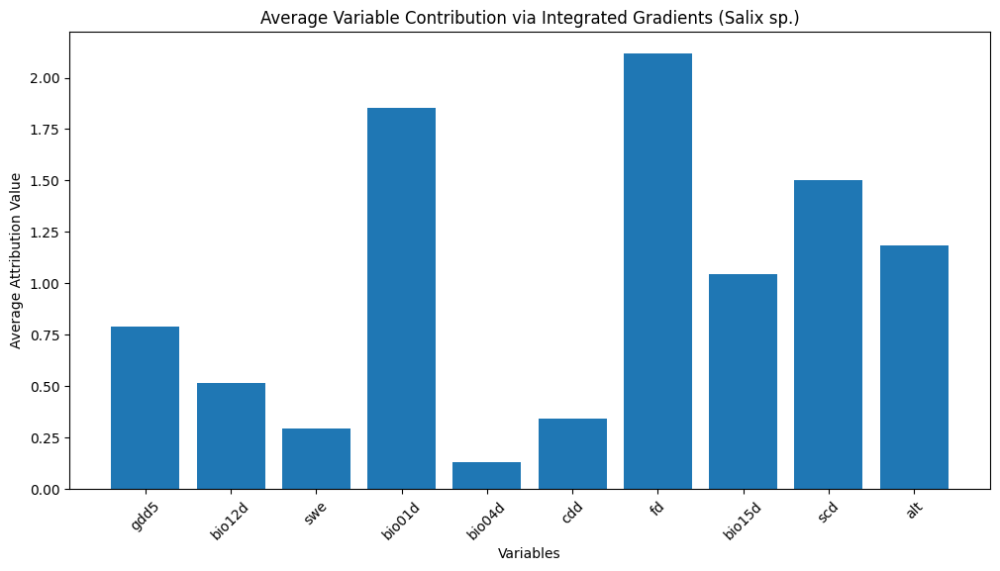

In [57]:
### Modificar para que printe ya directamente en la imagen el titulo de la target Sp

# Move the model to CPU (if it is on GPU)
MODEL = MODEL.to('cpu')

# Assuming selected_images is the list of images from your function
images_tensor = torch.stack(selected_images).to('cpu')  # Move to CPU

# List to store the attribution values for each image
all_channel_attributions = []
ig = IntegratedGradients(MODEL)

x = 0
# Loop through each image one by one
for img in selected_images:
    # Move the image to the correct device
    img_tensor = img.unsqueeze(0).to('cpu')  # Add batch dimension and move to device
    img_tensor.requires_grad_() # recomputar grafico con ordenador xavier
    # Calculate the attribution for the image (target the specific species index, e.g., 1060 for Salix)
    attributions, delta = ig.attribute(img_tensor, target=[1060], return_convergence_delta=True)

    # Aggregate the attribution by summing over height and width
    channel_attributions = torch.sum(torch.abs(attributions), dim=(2, 3))  # Sum over height and width for each channel

    # Convert to numpy and store it
    all_channel_attributions.append(channel_attributions.detach().cpu().numpy())
    x+=1
    # print(f'image {x} computed')

# Convert the list to a numpy array for easier averaging
all_channel_attributions = np.array(all_channel_attributions)

# Calculate the average attribution across all images (axis 0 is the batch dimension)
average_attributions = np.mean(all_channel_attributions, axis=0)

# Plot the average attribution values for each channel
plt.figure(figsize=(12, 6))
plt.bar(range(len(average_attributions[0])), average_attributions[0], tick_label=variables)
plt.title('Average Variable Contribution via Integrated Gradients (Salix sp.)')
plt.xlabel('Variables')
plt.xticks(rotation=45)
plt.ylabel('Average Attribution Value')
plt.show()



We can see that for salix reticulata the most important variables are the frost days (fd), the mean annual air temperature (bio01d) and the snow cover days (scd) as it is a specie that lives on alpine exposed areas with low snow accumulation.

### Plotting 1 species distribution

In [72]:
def plotting_one_species_distribution_norway(df, sp_name):    
    # Load the shapefile of Norway's boundaries (assuming you have this shapefile)
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)  # Make sure it's in EPSG:4326 for plotting
    
    # Get the index of the species in the species_universe
    index = species_universe[sp_name]
    
    # Create a boolean mask to filter rows where the species is present (predicted_vector[index] == 1)
    mask = df['predicted_vector'].apply(lambda x: x[index] == 1)  # Check if species is present in predicted_vector
    
    # Apply the mask to filter the DataFrame
    filtered_df = df[mask]
    filtered_df
    
    # Step 3: Plot the map
    fig, ax = plt.subplots(figsize=(10, 10))
    
    # Plot the Norway boundary
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    
    # Convert the filtered DataFrame into a GeoDataFrame
    result_geo_df = gpd.GeoDataFrame(
        filtered_df, 
        geometry=gpd.points_from_xy(filtered_df.longitude, filtered_df.latitude),
        crs="EPSG:4326"  # Ensure the correct CRS
    )
    
    # Plot the filtered points where the species is present
    result_geo_df.plot(ax=ax, markersize=3, color='red', alpha=0.5, label=f"{sp_name} Presence")
    
    # Customize plot
    ax.set_title(f"{sp_name} Distribution in Norway 2021-2040", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.legend()
    
    # Show the plot
    plt.show()

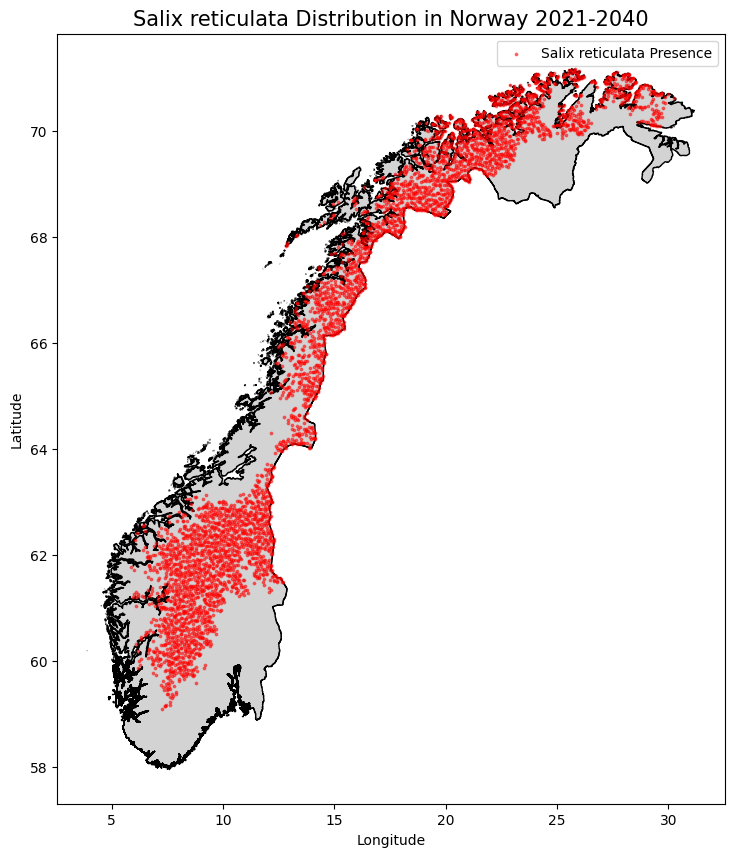

In [73]:
plotting_one_species_distribution_norway(df_2020_with_preds,'Salix reticulata')

### Plotting Multiple Species Distributions

In [74]:
def plotting_multiple_species_distribution_norway(df, species_list,tipo):    
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)
    
    fig, ax = plt.subplots(figsize=(12, 12))
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    
    colors = plt.get_cmap("tab10", len(species_list))  # Get distinct colors
    
    for i, sp_name in enumerate(species_list):
        index = species_universe[sp_name]
        mask = df['predicted_vector'].apply(lambda x: x[index] == 1)
        filtered_df = df[mask]

        result_geo_df = gpd.GeoDataFrame(
            filtered_df, 
            geometry=gpd.points_from_xy(filtered_df.longitude, filtered_df.latitude),
            crs="EPSG:4326"
        )
        result_geo_df.plot(
            ax=ax,
            markersize=3,
            # color=colors(i),
            color='red',
            alpha=0.6,
            label=sp_name
        )

    ax.set_title(f"{tipo }Species Distributions in Norway", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    # ax.legend(markerscale=2)
    plt.show()


In [75]:
alpine_sp_list = ['Salix lanata', 'Salix polaris', 'Betula nana',
                  'Harrimanella hypnoides', 'Micranthes stellaris', 
                  'Oxyria digyna', 
                  'Sibbaldia procumbens', 'Ranunculus glacialis'] #  'Minuartia biflora','Juncus trifidus'

treeline_sp_list = ['Picea abies','Betula pubescens','Pinus sylvestris',
                    'Salix caprea','Alnus incana', 
                    'Lathyrus linifolius', 'Knautia arvensis', 'Prunus padus'] #'Linnea borealis',

len(alpine_sp_list),len(treeline_sp_list)

(8, 8)

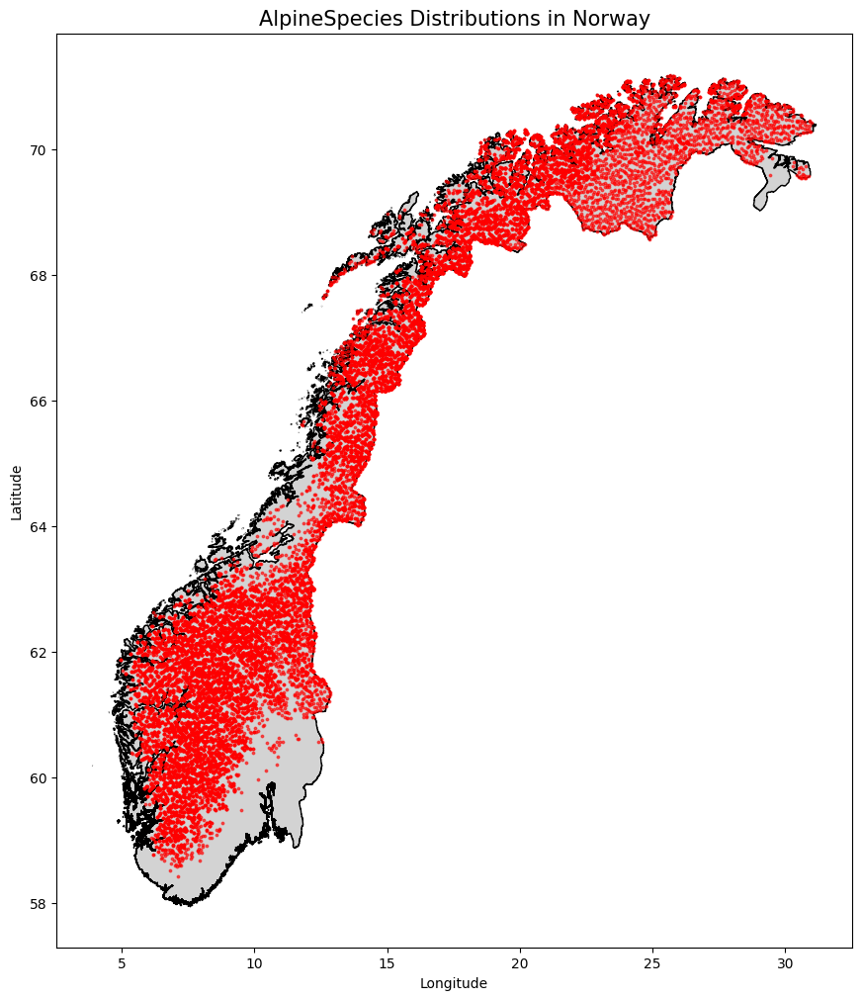

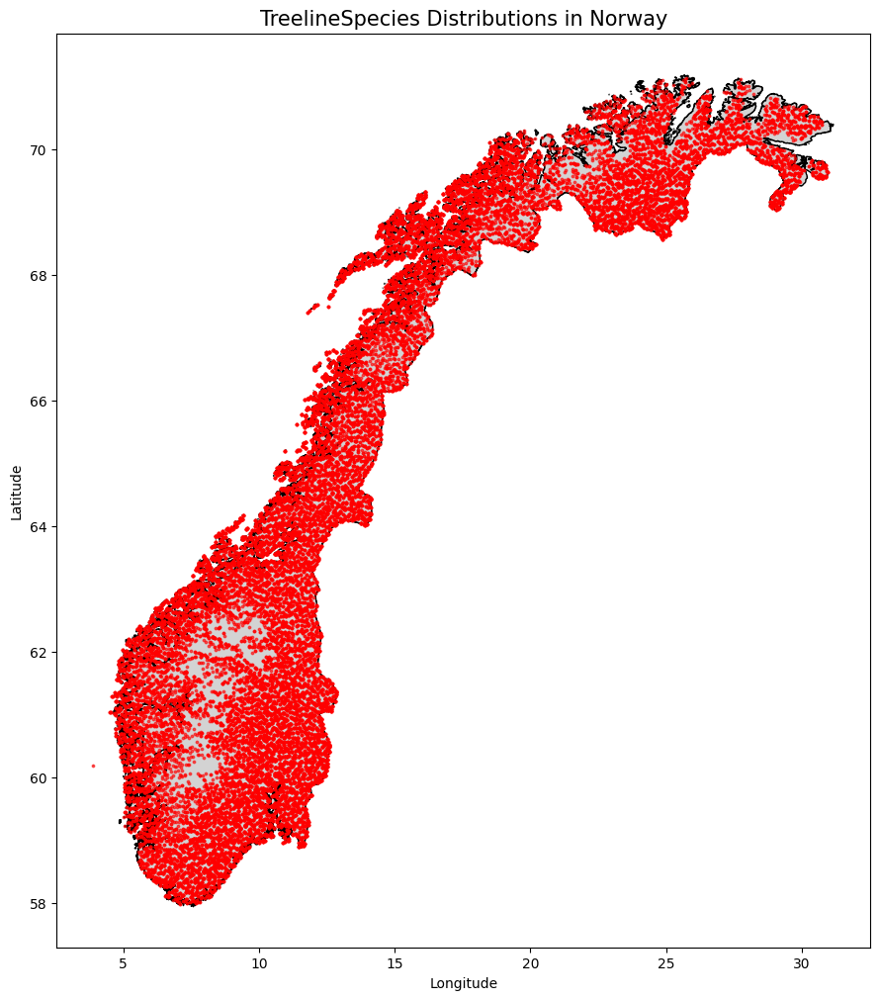

In [76]:

plotting_multiple_species_distribution_norway(df_2020_with_preds,alpine_sp_list,'Alpine')

plotting_multiple_species_distribution_norway(df_2020_with_preds,treeline_sp_list,'Treeline')

### Multiple Species Co-Ocurrence

In [77]:
def plotting_multiple_species_coocurrence_distribution_norway(df, species_list, tipo):    
    # Load Norway boundaries
    norway = gpd.read_file(r"../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)
    
    # Get the list of species indices
    indices = [species_universe[sp_name] for sp_name in species_list]
    
    # Create a mask: rows where ALL species are present (i.e., value == 1 for all indices)
    mask = df['predicted_vector'].apply(lambda x: sum(x[i] == 1 for i in indices) >= 3)
    
    # Filter the DataFrame using the mask
    filtered_df = df[mask]
    
    # Create a GeoDataFrame from the filtered data
    result_geo_df = gpd.GeoDataFrame(
        filtered_df, 
        geometry=gpd.points_from_xy(filtered_df.longitude, filtered_df.latitude),
        crs="EPSG:4326"
    )

    # Plotting
    fig, ax = plt.subplots(figsize=(12, 12))
    norway.plot(ax=ax, color="lightgray", edgecolor="black")
    result_geo_df.plot(
        ax=ax,
        markersize=3,
        color='red',
        alpha=0.6,
        label=f"All species: {', '.join(species_list)}"
    )

    ax.set_title(f"Simultaneous Distribution of Species in Norway ({tipo})", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    # ax.legend()
    plt.show()


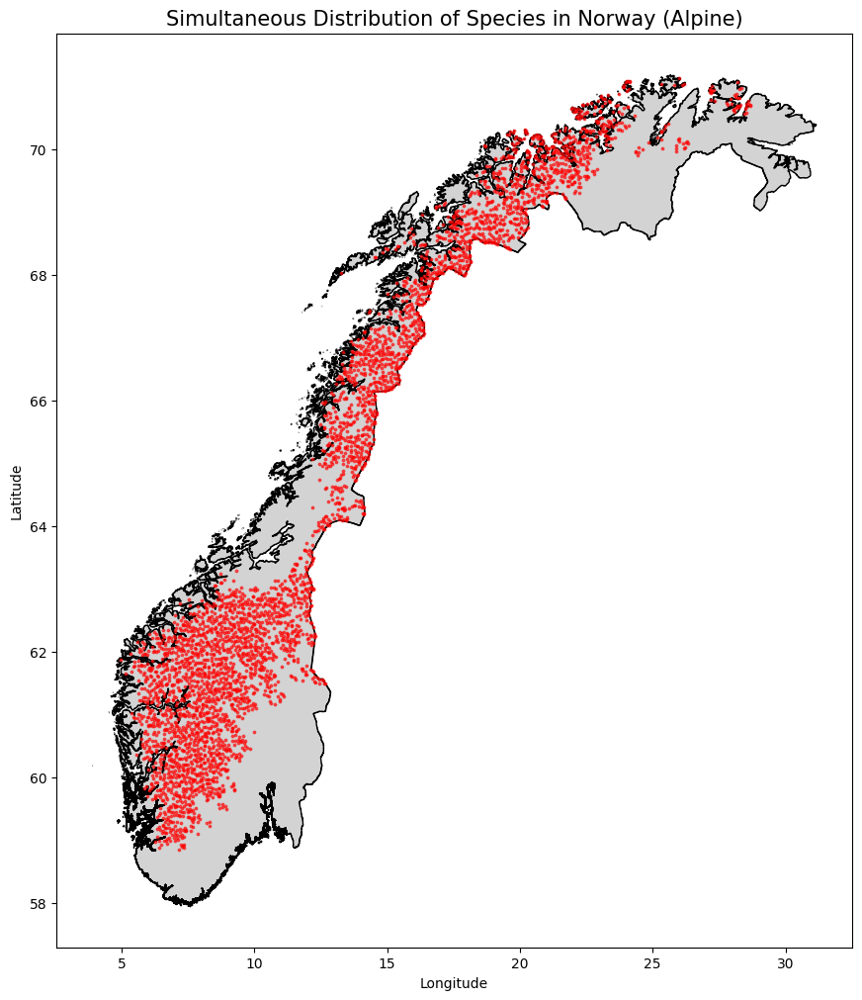

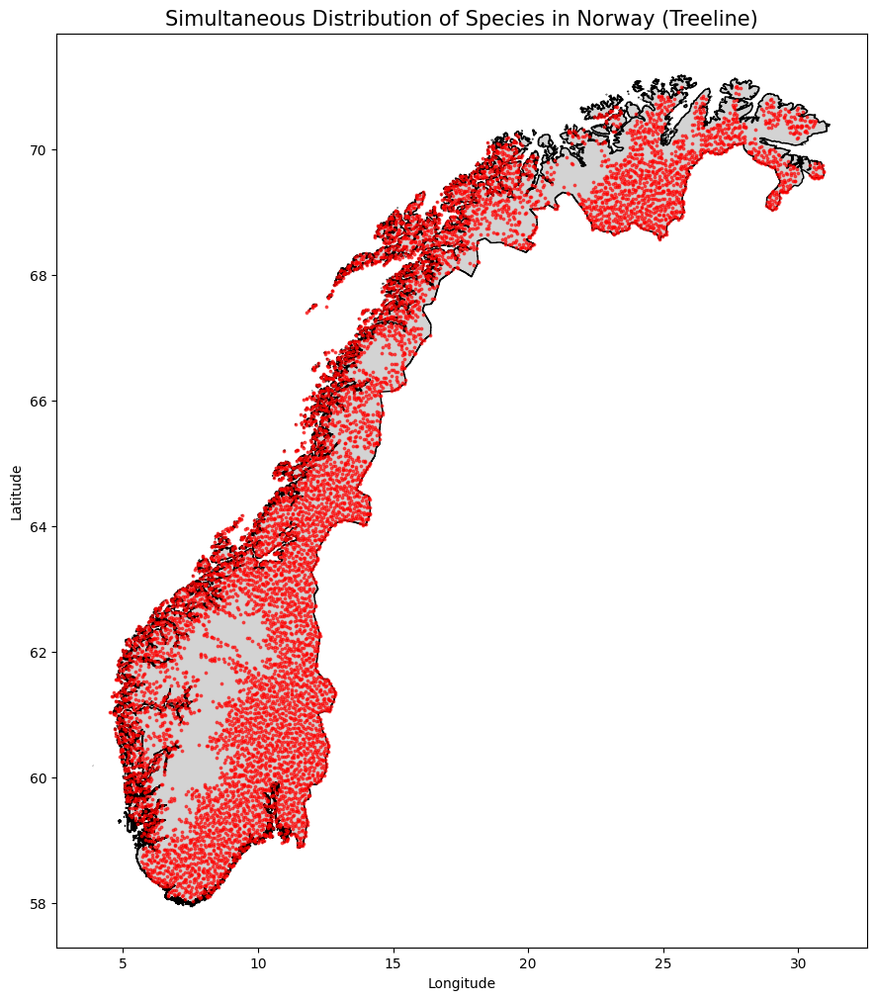

In [78]:

plotting_multiple_species_coocurrence_distribution_norway(df_2020_with_preds,alpine_sp_list,'Alpine')

plotting_multiple_species_coocurrence_distribution_norway(df_2020_with_preds,treeline_sp_list,'Treeline')

### Combined Plot

In [79]:
def plot_combined_species_groups(df, alpine_species, treeline_species, tipo="Combined"):

    # Load Norway shapefile
    norway = gpd.read_file("../data/gadm41_NOR_shp/gadm41_NOR_0.shp").to_crs(epsg=4326)

    fig, ax = plt.subplots(figsize=(12, 12))
    norway.plot(ax=ax, color="lightgray", edgecolor="black")

    # Process both groups
    for group_name, species_list, color in [
        ("Alpine", alpine_species, "blue"),
        ("Treeline", treeline_species, "green")
    ]:
        # Get indices
        indices = [species_universe[sp] for sp in species_list]

        # Keep only rows where ALL species in this group are present
        mask = df['predicted_vector'].apply(lambda x: sum(x[i] == 1 for i in indices) >= 3)
        filtered_df = df[mask]

        # Convert to GeoDataFrame
        geo_df = gpd.GeoDataFrame(
            filtered_df,
            geometry=gpd.points_from_xy(filtered_df.longitude, filtered_df.latitude),
            crs="EPSG:4326"
        )

        # Plot
        geo_df.plot(ax=ax, markersize=4, color=color, alpha=0.6, label=f"{group_name} spp. ({len(geo_df)})")

    # Final plot settings
    ax.set_title(f"Alpine - Treeline 2021-2040 Species Co-occurrence in Norway", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    ax.legend()
    plt.savefig(f"../Images/Alpine-Treeline_2021-2040_Species_Co-occurrence_in_Norway.png")
    plt.show()


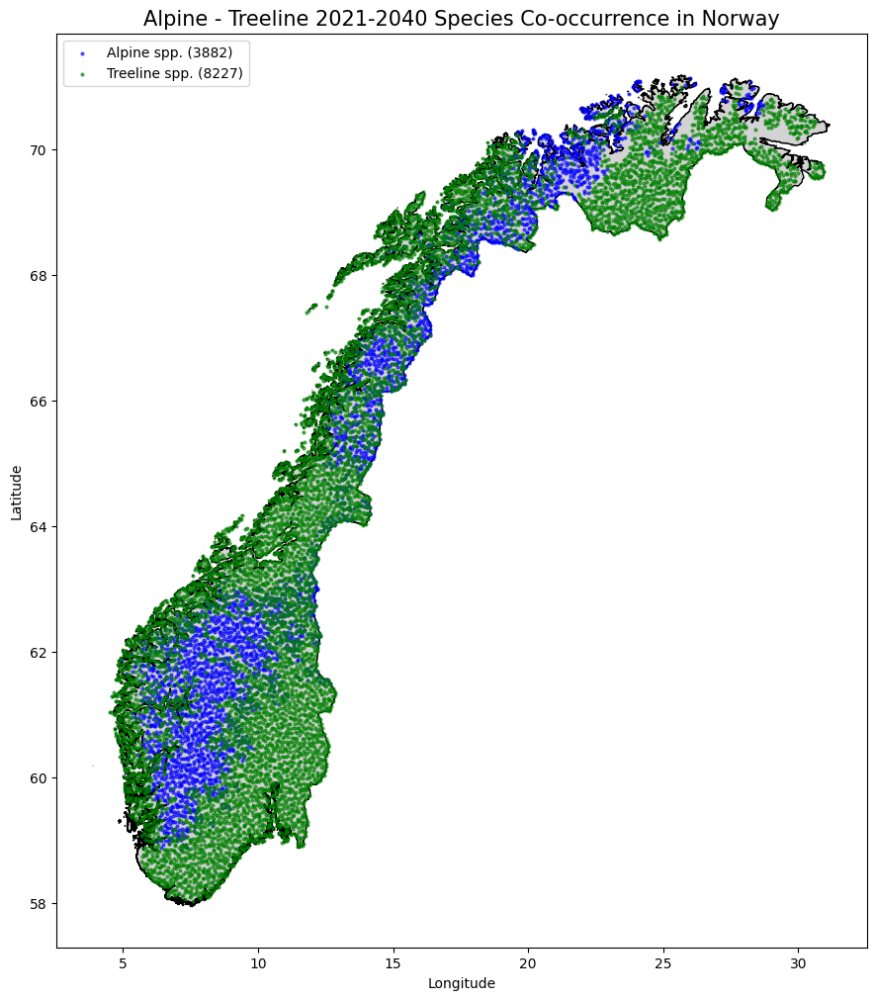

In [80]:
plot_combined_species_groups(df_2020_with_preds,alpine_sp_list,treeline_sp_list)

### Tests

In [76]:
# Create a boolean mask to filter rows where the species is present (predicted_vector[index] == 1)
specie_index = species_universe['Salix reticulata']
mask = df_2018_with_preds['predicted_vector'].apply(lambda x: x[specie_index] == 1)  # Check if species is present in predicted_vector

# Apply the mask to filter the DataFrame
filtered_df = df_2018_with_preds[mask]
filtered_df

,geometry,latitude,longitude,climatic_map,predicted_vector,predicted_richness
702,"POLYGON ((7.36511 59.20052, 7.36311 59.20943, ...",59.205487,7.372789,"[[[846.0515, 11.944797, 6.769123, 19.826292, 2...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",244
1036,"POLYGON ((6.80914 59.53648, 6.80697 59.54537, ...",59.541479,6.816806,"[[[1063.2517, 16.470514, 9.478959, 20.575836, ...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",205
1037,"POLYGON ((6.86381 59.53089, 6.86165 59.53978, ...",59.535884,6.871480,"[[[738.00146, 16.818768, 9.74937, 21.670605, 2...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",225
1042,"POLYGON ((7.27896 59.50208, 7.27691 59.51098, ...",59.507048,7.286689,"[[[715.8514, 13.463226, 8.127726, 23.035929, 1...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",237
1045,"POLYGON ((7.55127 59.55403, 7.5493 59.56293, 7...",59.558984,7.559057,"[[[1173.3517, 6.4480596, 3.8052602, 8.6776085,...","[1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 1.0, 0.0, 0.0, ...",246
...,...,...,...,...,...,...
11465,"POLYGON ((25.54981 71.16021, 25.54816 71.1603,...",71.160690,25.549503,"[[[637.80164, 4.4906416, 3.6369588, 7.25763, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",297
11466,"POLYGON ((25.63646 71.16434, 25.63161 71.15553...",71.160205,25.621730,"[[[759.7518, 3.6270177, 2.9027944, 5.537686, 4...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",313
11467,"POLYGON ((25.6686 71.17158, 25.64607 71.17288,...",71.175275,25.662772,"[[[642.4016, 4.3417897, 3.4682465, 6.837236, 3...","[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",301
11468,"POLYGON ((25.80495 71.16368, 25.77769 71.16527...",71.166685,25.790593,"[[[557.50146, 4.8412805, 3.8488493, 9.09052, 2...","[1.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",303


In [77]:
mask

0        False
1        False
2        False
3        False
4        False
         ...  
11465     True
11466     True
11467     True
11468     True
11469     True
Name: predicted_vector, Length: 11470, dtype: bool